## Mount Google-Drive (if colab engine is in use) & Specify the folder to where we will carrying out our operations.

In [1]:
# !pwd = shows current working directory
# If u want to execute terminal command, start with !
# Specify location
abs_path = "/home/rodo/IIITH-1st-Sem/DIP/Assignments/assignment_1-rodosingh/"

## Import Essential Libraries...

In [2]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt
import matplotlib as mlp
%matplotlib inline

## Question 1

1. (30 points) __Harry’s Escape__ <br>
The Harry Potter series are a widely acclaimed global phenomenon now. In the concluding book, Harry Potter and the Deathly Hallows, Voldemort has his evil forces in place to capture Harry while he tries to safely reach The Burrow. In order to escape successfully without being traced by his nemesis, all 6 of Harry’s associates use the Polyjuice potion to disguise themselves as his alter egos so that his enemy is left baffled and can’t determine who the real Harry Potter is. <br><br> The smartest auror in the team and your most experienced associate, Mad Eye Moody further advises you to make the plan foolproof by covering your tracks through the generation of fake images. To teach you, Harry, Moody has shown an example of image matting where you will take an image of yourself on a green screen and add a fake background to it. <br> How does the green screen help in this task?

Foreground Image             |  Background Image | Required Image
:-------------------------:|:-------------------------:| :-------------------------:
![Image](https://drive.google.com/uc?id=1_YvfHPDdrz1rMy4ncdGnphG7jxHXQPeP) | ![Image](https://drive.google.com/uc?id=1FAo3fpRwyP9oh0ZqOEolAiq55WkgV0la)| ![Image](https://drive.google.com/uc?id=1bL4zSYhjNFO3C6YqJXmeHqBe7mCtX4ar)

2. Generate images for your fake trail to leave for Voldemort and the death eaters using this method.
    1. Test your implementation using the provided foreground(fg.jpg) and background(bg.jpg). 
    2. Graft Harry Potter onto Hogwarts. Find this magic school’s image from the internet. 
    3. Be creative and try out with different foreground and background images of your choice and show the results.

3. Moody also wants to know how many images of size 720 x 576 can be stored if cloud of size 2 GB is available. Assuming images are stored for displaying on standard displays, calculate the number of images you can store in the cloud.

#### Question 1.2.1

In [3]:
# read image...
fg_img = cv2.imread(abs_path + "/images/fg.jpg")
bg_img = cv2.imread(abs_path + "/images/bg.jpg")

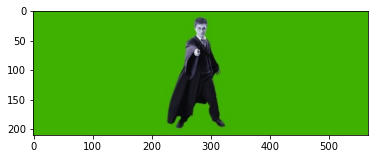

In [4]:
# Actual foreground Image
plt.imshow(fg_img)

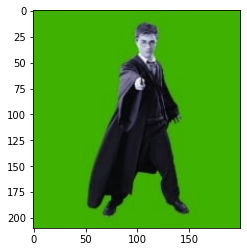

In [5]:
# since here the foreground image is covered up by green values, we crop it.
crop_fg_img = fg_img[:, 175:175 + 200]
plt.imshow(crop_fg_img)

###### __First Approach__: Our first idea is to replace the green pixels in fg.jpg with the pixels from background image (i.e. bg.jpg)

In [3]:
def required_divisor(scaling_val, threshold):
    div = 1
    while scaling_val > threshold:
        scaling_val //= 2
        div *= 2
    return div


# foreground Image resizer
def fg_img_resize(fg_img, bg_img):
    # asks if user wants to change fg img size
    user_wants = int(
        input("Enter 1 if u want to change fg image size or else 0: "))
    if user_wants:
        # ask from user what should be the size of fg image w.r.t bg in terms of %
        img_perc = int(
            input(
                "Enter what percentage of shortest dimension (excluding channel) of background image should be covered by foreground image: "
            ))
        fg_shape = fg_img.shape
        bg_shape = bg_img.shape
        """
        scaling function:
        1. find min among width and height for bg
        2. Along that min axis we will do scaling for fg, which will effect in other-axis too.
        """
        min_axis = np.argmin(bg_shape[:-1])  # excluding channel dim
        scale = (img_perc / 100) * (
            bg_shape[min_axis] / fg_shape[min_axis]
        )  # - wrong-formula --- np.sqrt(scale_x*scale_y*(img_perc/100))
        fg_img = cv2.resize(fg_img, (0, 0), fx=scale, fy=scale)
    return fg_img


# resize images automatically to suitable size according to given fg and bg images.
def img_resizer(fg_img, bg_img):
    fg_shape = fg_img.shape
    bg_shape = bg_img.shape
    scale_x = bg_shape[1] / fg_shape[1]
    scale_y = bg_shape[0] / fg_shape[0]
    if (fg_shape[1] <= bg_shape[1]) or (fg_shape[0] <= bg_shape[0]):
        if scale_x > 4 or scale_y > 4:
            # here do both x and y bg downscaling unless go by user input.
            x_divisor = required_divisor(scale_x, 4)
            y_divisor = required_divisor(scale_y, 4)
            scale = max(x_divisor, y_divisor)
            bg_img = cv2.resize(bg_img, (0, 0), fx=(1 / scale), fy=(1 / scale))
        fg_img = fg_img_resize(fg_img, bg_img)
    else:
        # check if background img is too small
        if (1 / scale_x) > 2 or (1 / scale_y) > 2:
            bg_img = cv2.resize(bg_img, (0, 0), fx=2, fy=2)
        fg_img = fg_img_resize(fg_img, bg_img)
    return fg_img, bg_img


# Place foreground inage on background image at desired position
def img_placer(x_pos_perc, y_pos_perc, fg_img, bg_img):
    """
    Input: 
        x_pos_perc: percentage of x-co-ordinate of centre of foreground image on background - w.r.t to top left of background image.
        y_pos_perc: percentage of y-co-ordinate of centre of foreground image on background - w.r.t to top left of background image.
        fg_img: foreground image
        bg_img: background image
    Output:
        Required Co-ordinates for top left of foreground image on background image
    """
    fg_shape = fg_img.shape
    bg_shape = bg_img.shape
    return round((x_pos_perc / 100) * (bg_shape[1] - fg_shape[1])), round(
        (y_pos_perc / 100) * (bg_shape[0] - fg_shape[0]))


# this function simply replaces the green pixels in fg.jpg with the pixels from bg.jpg.
def image_matting_func(fg_img, bg_img, mode="BGR"):
    """
    Input:
        fg_img: Cropped/ Focused Foreground Image
        bg_img: Background Image
        mode: "BGR" or "HSV"
    Output:
        Replaced Image with RGB format
    """
    bg_tmp = np.copy(
        bg_img
    )  # to prevent changes in original image array; as call by reference
    # Resize to convenience
    fg_img, bg_tmp = img_resizer(fg_img, bg_tmp)
    # store the shape
    fg_shape = fg_img.shape
    # asks for perfect positioning.
    x_pos_perc = int(
        input(
            "Enter the distance percentage in x-direction for top-left of foreground image to be placed on background: "
        ))
    y_pos_perc = int(
        input(
            "Enter the distance percentage in y-direction for top-left of foreground image to be placed on background: "
        ))
    # obtain the co-ordinates on background image to which foreground image is to be placed at.
    x_cord, y_cord = img_placer(x_pos_perc, y_pos_perc, fg_img, bg_tmp)
    if mode == "BGR":
        for i, i1 in enumerate(range(y_cord, y_cord +
                                     fg_shape[0])):  # as y_cord is included
            for j, j1 in enumerate(range(x_cord, x_cord + fg_shape[1])):
                # idea: replace the background pixel with foreground's object's pixel (which in our case refers to harry potter)
                # Below is the RGB range where we can find green pixel, we just took complement of it.
                if not ((0 <= fg_img[i][j][0] <= 255) and
                        (168 <= fg_img[i][j][1] <= 183) and
                        (0 <= fg_img[i][j][2] <= 255)):
                    bg_tmp[i1][j1][0] = fg_img[i][j][
                        0]  #replacing the bg pixel with fg for BLUE channel.
                    bg_tmp[i1][j1][1] = fg_img[i][j][1]
                    bg_tmp[i1][j1][2] = fg_img[i][j][2]
    else:
        fg_img = cv2.cvtColor(fg_img, cv2.COLOR_BGR2HSV)
        bg_tmp = cv2.cvtColor(bg_tmp, cv2.COLOR_BGR2HSV)
        for i, i1 in enumerate(range(y_cord, y_cord +
                                     fg_shape[0])):  # as y_cord is included
            for j, j1 in enumerate(range(x_cord, x_cord + fg_shape[1])):
                # Below is the HSV range where we can find green pixel, we just took complement of it.
                if not ((50 <= fg_img[i][j][0] <= 75) and
                        (50 <= fg_img[i][j][1] <= 255) and
                        (50 <= fg_img[i][j][2] <= 255)):
                    bg_tmp[i1][j1][0] = fg_img[i][j][
                        0]  #replacing the bg pixel with fg for BLUE channel.
                    bg_tmp[i1][j1][1] = fg_img[i][j][1]
                    bg_tmp[i1][j1][2] = fg_img[i][j][2]
        bg_tmp = cv2.cvtColor(bg_tmp, cv2.COLOR_HSV2BGR)
    return cv2.cvtColor(bg_tmp, cv2.COLOR_BGR2RGB)

Enter 1 if u want to change fg image size or else 0: 1
Enter what percentage of shortest dimension (excluding channel) of background image should be covered by foreground image: 70
Enter the distance percentage in x-direction for top-left of foreground image to be placed on background: 50
Enter the distance percentage in y-direction for top-left of foreground image to be placed on background: 97


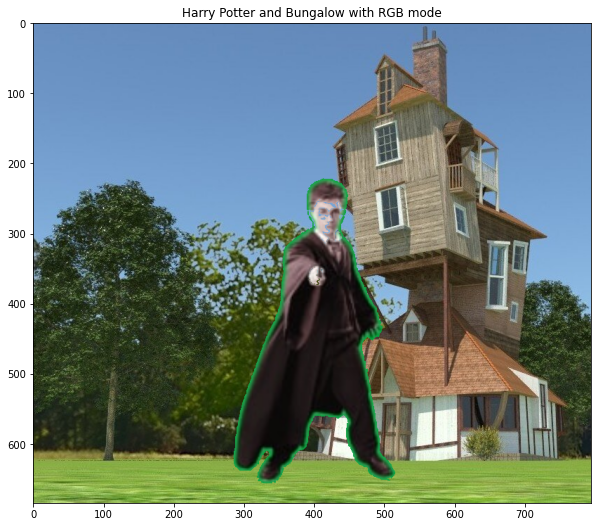

In [43]:
bg_transformed_bgr = image_matting_func(fg_img=crop_fg_img,
                                        bg_img=bg_img,
                                        mode="BGR")
plt.figure(figsize=(10, 20))
plt.imshow(bg_transformed_bgr)
plt.title("Harry Potter and Bungalow with RGB mode")
plt.show()

Enter 1 if u want to change fg image size or else 0: 1
Enter what percentage of shortest dimension (excluding channel) of background image should be covered by foreground image: 70
Enter the distance percentage in x-direction for top-left of foreground image to be placed on background: 50
Enter the distance percentage in y-direction for top-left of foreground image to be placed on background: 98


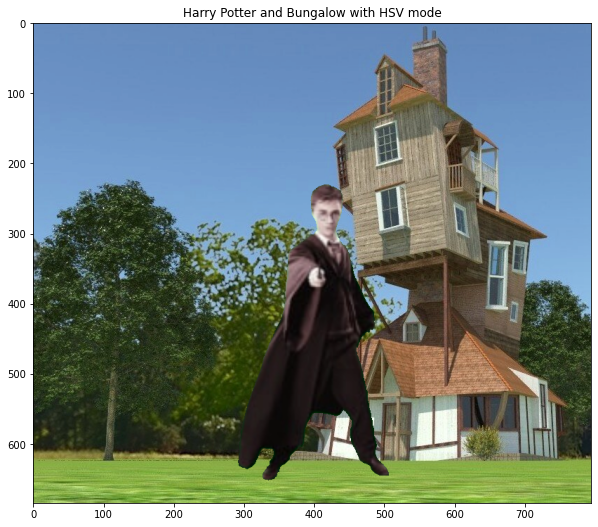

In [45]:
bg_transformed_hsv = image_matting_func(fg_img=crop_fg_img,
                                        bg_img=bg_img,
                                        mode="HSV")
plt.figure(figsize=(10, 20))
plt.imshow(bg_transformed_hsv)
plt.title("Harry Potter and Bungalow with HSV mode")
plt.show()

###### Here we can do some analysis: 

1. In HSV format we can see some greenish lines are absent which was not the case for RGB.
2. Second, the greenish outline we are getting in RGB is due to image enlargement. Due to which, the pixel size increases in foreground image. And hence at the borderline (i.e. where green chenges to black) __smoothening__ effect took place (according to my guess) and as a result both green and black colours can be seen in single pixel. Since, there is some component of black, according to our code that is not counted in green but that's not the case with HSV.
3. Also, we can see Harry Potter's __cheek__ to be deformed somewhat which is due to replacement of background pixel at that point.

__One main question is how we got to know on which HSV range green pixel lies?__
We just pass the BGR values of green pixel to find the HSV value of Green, try the following:
```python3
>>> green = np.uint8([[[0,255,0 ]]])
>>> hsv_green = cv2.cvtColor(green,cv2.COLOR_BGR2HSV)
>>> print( hsv_green )
[[[ 60 255 255]]]
```
Now we take `[H-10, 50, 50]` and `[H+10, 255, 255]` as the lower bound and upper bound respectively.

###### __Second Approach__: It is more or less similar to the first one. Here we will develop a mask and accordingly we will replace pixels in background image with foreground one.

* For __mask__ we can take help of `cv2.inRange()` function from __OpenCV__ library.
* And our idea is basically the same as above i.e., replace the pixel in background image with pixel from foreground whenever we encounter white pixel in mask otherwise we just don't do anything. So __mask__ is just an intermediate step.
* To shorten the steps of pixel replacement we have done above, we will use `cv2.bitwise_not()` (that create __inverse mask__), `cv2.bitwise_and()` (that expose required/focused part of foreground while keeping the rest as black or pixel 0), and `cv2.add()` that add exposed parts of two images throwing mask's black part away.

In [48]:
def mask_the_background(fg_img, bg_img, mode="BGR"):
    """
    Input:
        fg_img: Cropped/ Focused Foreground Image
        bg_img: Background Image
        mode: "BGR" or "HSV"
    Output:
        Replaced Image with RGB format
    """
    bg_tmp = np.copy(
        bg_img
    )  # to prevent changes in original image array; as call by reference
    # Resize to convenience
    fg_img, bg_tmp = img_resizer(fg_img, bg_tmp)
    # store the shape
    fg_shape = fg_img.shape
    # asks for perfect positioning.
    x_pos_perc = int(
        input(
            "Enter the distance percentage in x-direction for top-left of foreground image to be placed on background: "
        ))
    y_pos_perc = int(
        input(
            "Enter the distance percentage in y-direction for top-left of foreground image to be placed on background: "
        ))
    # obtain the co-ordinates on background image to which foreground image is to be placed at.
    x_cord, y_cord = img_placer(x_pos_perc, y_pos_perc, fg_img, bg_tmp)
    # create mask and anti-mask for both modes
    if mode == "BGR":
        # Range of green colour in BGR.
        upper = np.array([255, 179, 255])
        lower = np.array([0, 173, 0])
        # Obtain ROI from background img where foreground is to be put.
        roi_bg = bg_tmp[y_cord:y_cord + fg_shape[0],
                        x_cord:x_cord + fg_shape[1]]
    elif mode == "HSV":
        # Range of green in HSV.
        upper = np.array([75, 255, 255])
        lower = np.array([50, 50, 50])
        fg_img = cv2.cvtColor(fg_img, cv2.COLOR_BGR2HSV)
        bg_tmp = cv2.cvtColor(bg_tmp, cv2.COLOR_BGR2HSV)
        # Obtain ROI from background img where foreground is to be put.
        roi_bg = bg_tmp[y_cord:y_cord + fg_shape[0],
                        x_cord:x_cord + fg_shape[1]]
    # Mask that allows green to display == Construction of anti-mask (1-bit image)
    rgb_anti_mask = cv2.inRange(fg_img, lower, upper)
    # Mask that display Harry, and blocks green
    rgb_mask = cv2.bitwise_not(rgb_anti_mask)
    # Apply anti-mask on ROI obtained from Background image, so as to display the background part.
    masked_roi = cv2.bitwise_and(roi_bg, roi_bg, mask=rgb_anti_mask)
    # Apply mask on fg
    masked_fg = cv2.bitwise_and(fg_img, fg_img, mask=rgb_mask)
    # Add both masked entities and put that back in original image
    bg_tmp[y_cord:y_cord + fg_shape[0],
           x_cord:x_cord + fg_shape[1]] = cv2.add(masked_roi, masked_fg)
    if mode == "BGR":
        return cv2.cvtColor(bg_tmp, cv2.COLOR_BGR2RGB)
    else:
        return cv2.cvtColor(bg_tmp, cv2.COLOR_HSV2RGB)

Enter 1 if u want to change fg image size or else 0: 1
Enter what percentage of shortest dimension (excluding channel) of background image should be covered by foreground image: 70
Enter the distance percentage in x-direction for top-left of foreground image to be placed on background: 50
Enter the distance percentage in y-direction for top-left of foreground image to be placed on background: 98


Text(0.5, 1.0, 'Harry Potter and Bungalow with RGB mode')

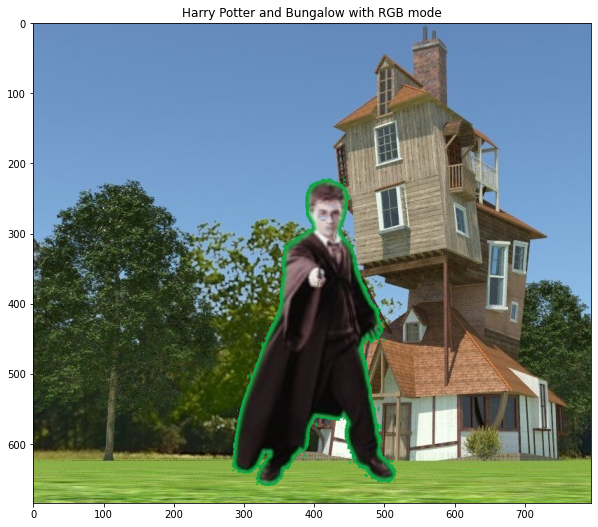

In [49]:
bg_masked_bgr = mask_the_background(fg_img=crop_fg_img,
                                    bg_img=bg_img,
                                    mode="BGR")
plt.figure(figsize=(10, 20))
plt.imshow(bg_masked_bgr)
plt.title("Harry Potter and Bungalow with RGB mode")
plt.show()

Enter 1 if u want to change fg image size or else 0: 1
Enter what percentage of shortest dimension (excluding channel) of background image should be covered by foreground image: 70
Enter the distance percentage in x-direction for top-left of foreground image to be placed on background: 50
Enter the distance percentage in y-direction for top-left of foreground image to be placed on background: 98


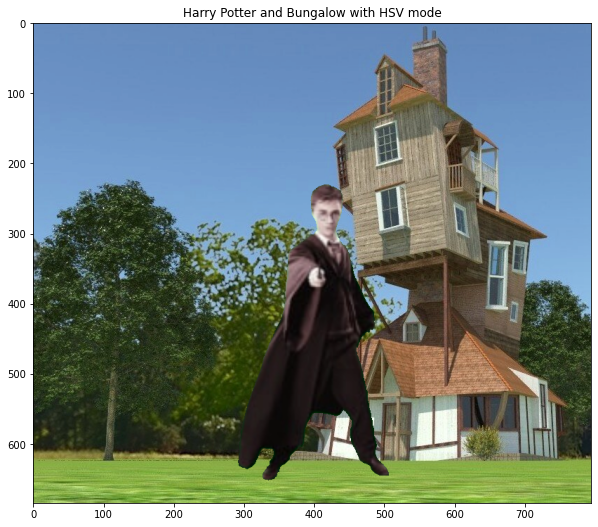

In [50]:
bg_masked_hsv = mask_the_background(fg_img=crop_fg_img,
                                    bg_img=bg_img,
                                    mode="HSV")
plt.figure(figsize=(10, 20))
plt.imshow(bg_masked_hsv)
plt.title("Harry Potter and Bungalow with HSV mode")
plt.show()

#### Question 1.2.2

Since we have exhibited using HSV color range provides a clear grafting of foreground image upon background image, we will use `mode == "HSV"` for this part.

In [51]:
# read the  image file
hogwarts = cv2.imread(abs_path + "images/hogwarts.png")

Enter 1 if u want to change fg image size or else 0: 1
Enter what percentage of shortest dimension (excluding channel) of background image should be covered by foreground image: 40
Enter the distance percentage in x-direction for top-left of foreground image to be placed on background: 75
Enter the distance percentage in y-direction for top-left of foreground image to be placed on background: 90


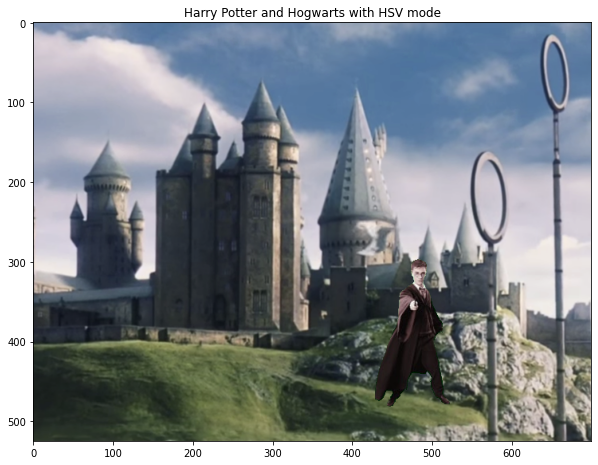

In [52]:
hogwarts_masked_hsv = mask_the_background(fg_img=crop_fg_img,
                                          bg_img=hogwarts,
                                          mode="HSV")
plt.figure(figsize=(10, 20))
plt.imshow(hogwarts_masked_hsv)
plt.title("Harry Potter and Hogwarts with HSV mode")
plt.show()

#### Question 1.2.3

In [53]:
# Plot the required images.
def plotter(lst, names):
    """
    Input:
        kwargs:
            1. lst: [fg_img, bg_img, resulting_img]
            2. names: [fg_img_name, bg_img_name, result_name]
    """
    fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(20, 30))
    for i in range(3):
        if i != 2:
            ax[i].imshow(cv2.cvtColor(lst[i], cv2.COLOR_BGR2RGB))
        else:
            ax[i].imshow(lst[i])
        ax[i].set_title(names[i])
    fig.tight_layout(rect=[0, 0, 1, 0.95])
    #plt.show()


# Changes background of given fg images
def background_transformer(fg_image_lst, fg_names_lst, bg_image_lst,
                           plot_names):
    """
    Input:

    1. fg_image_lst: List of cropped/ cleaned foreground images
    2. bg_image_lst: Their corresponding background images
    3. plot_names: list of titles to be set for resulting images
    """
    for fg_image, fg_name, bg_image, name in zip(fg_image_lst, fg_names_lst,
                                                 bg_image_lst, plot_names):
        # Enter image transformation details:
        print(
            f"Enter the Image Transformation details for {fg_name.split('.')[0]} as foreground"
        )
        # Transform
        bg_masked_hsv = mask_the_background(fg_img=fg_image,
                                            bg_img=bg_image,
                                            mode="HSV")
        # Show:
        plotter(lst=[fg_image, bg_image, bg_masked_hsv],
                names=["Foreground", "Background", name])

In [ ]:
# Let's read all the images...
fg_img_names = [
    "carry.png", "anime.jpg", "anime.jpg", "anime.jpg", "transformer.jpg",
    "bulldog.jpg"
]
bg_img_names = [
    "carry_back.jpg", "anime_back1.jpg", "anime_back2.png", "anime_back3.jpg",
    "transformer_back.jpg", "dog_back.jpg"
]
plot_names = [
    "Carry Bhai ki Swaaaaaggggg!", "Girl & Guns - Part I",
    "Girl & Guns - Part II", "Girl & Guns - Part III", "BumbleBee v/s OPTIMUS",
    "Cute DOGGIE!"
]
fg_img_lst = []
bg_img_lst = []
for fg_name, bg_name in zip(fg_img_names, bg_img_names):
    fg_img_lst.append(cv2.imread(abs_path + "images/" + fg_name))
    bg_img_lst.append(cv2.imread(abs_path + "images/" + bg_name))

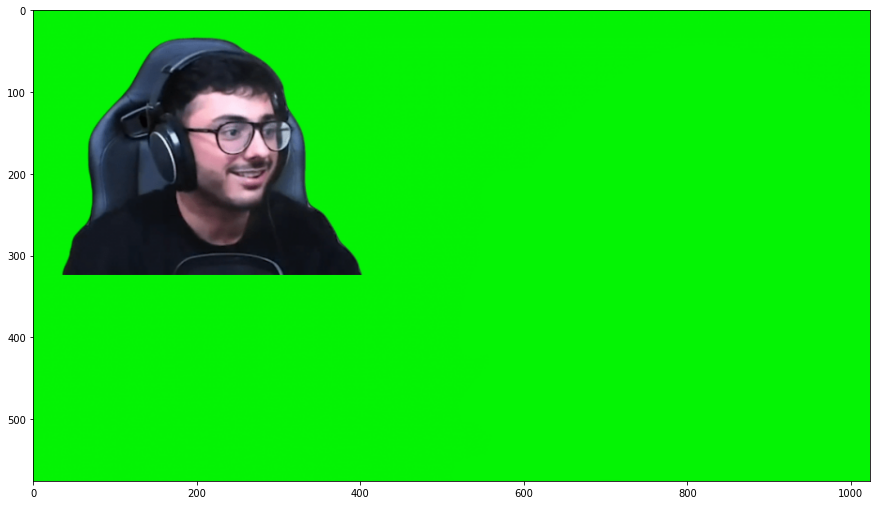

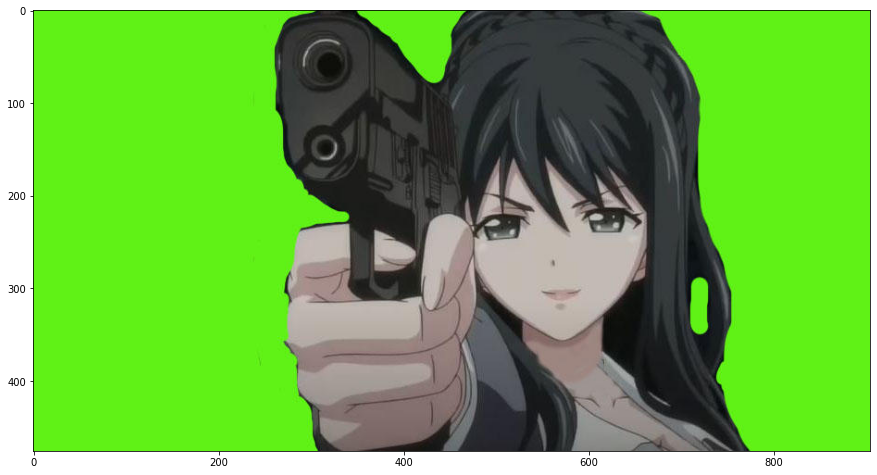

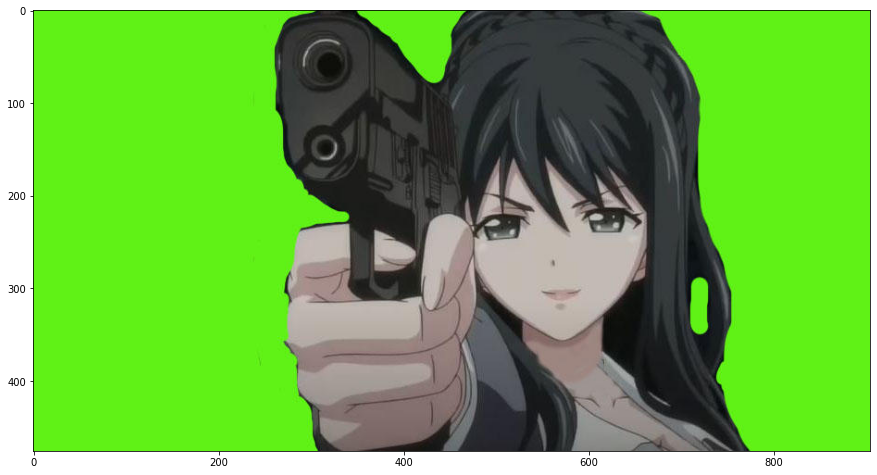

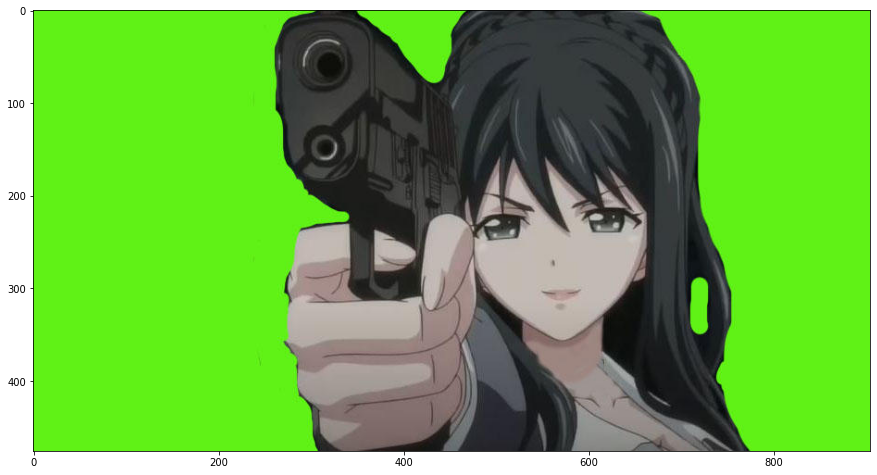

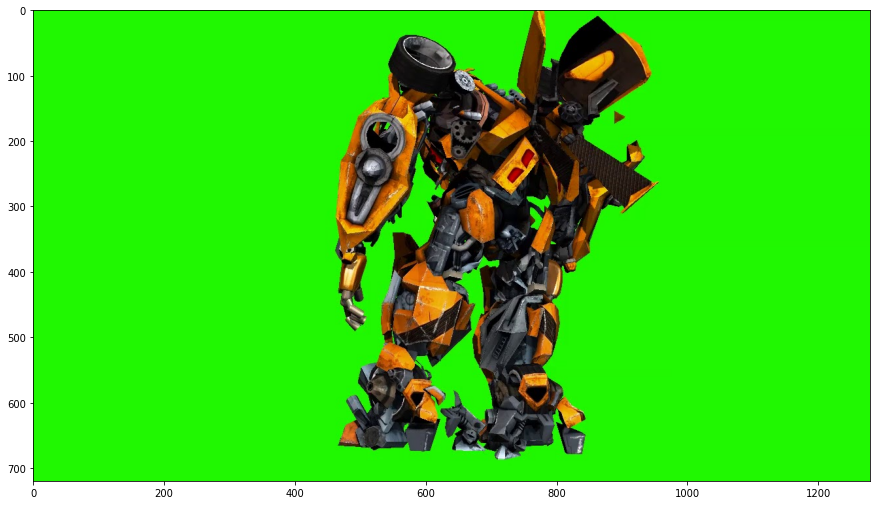

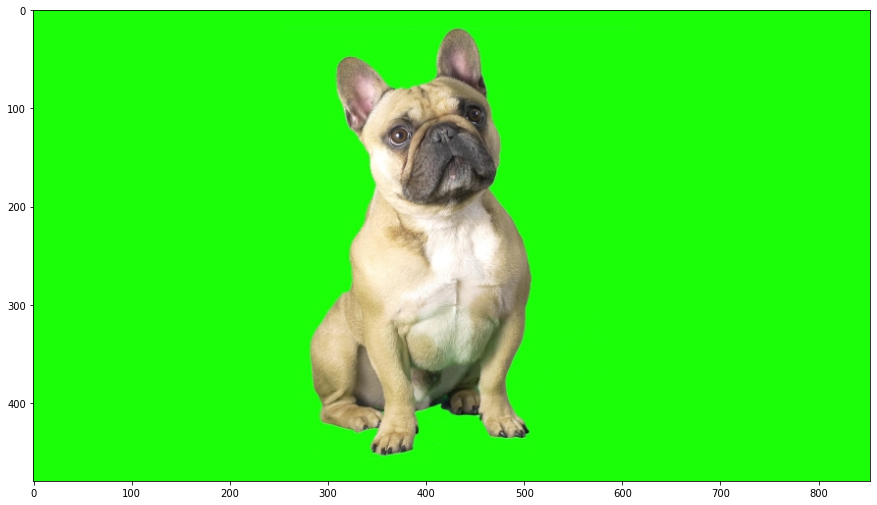

In [ ]:
# Show fg images
for image in fg_img_lst:
    plt.figure(figsize=(15, 10))
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.show()

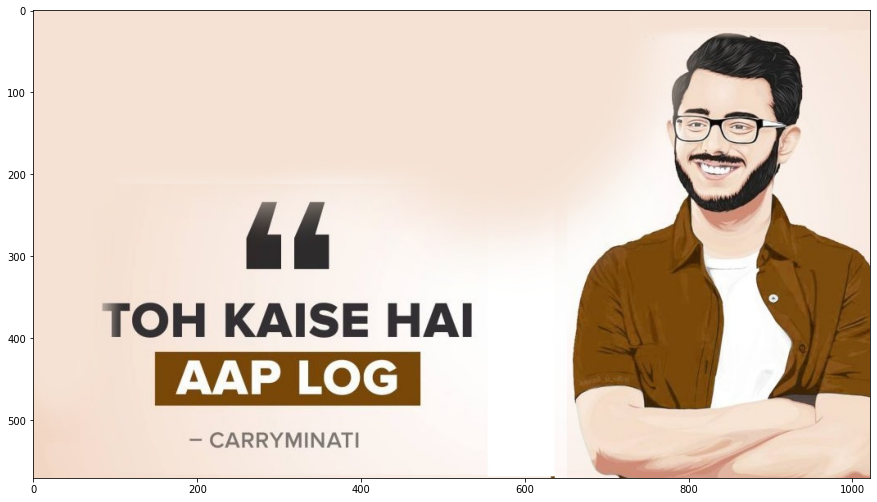

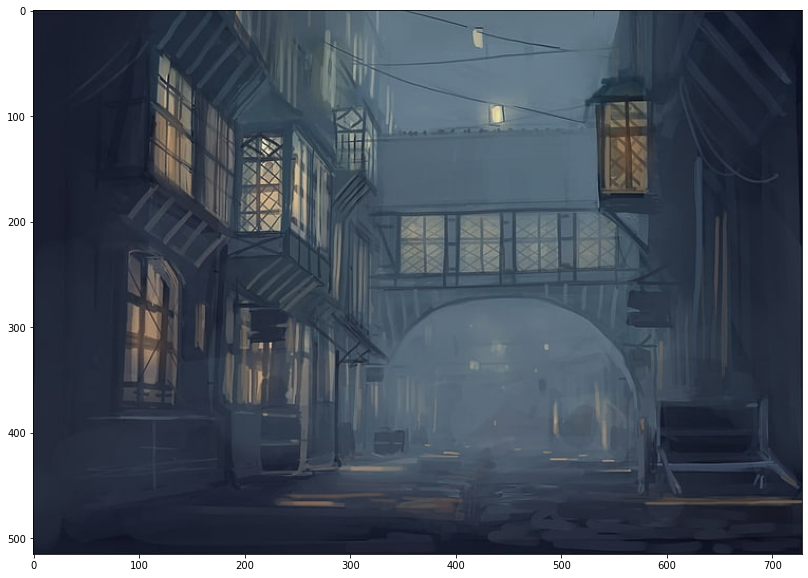

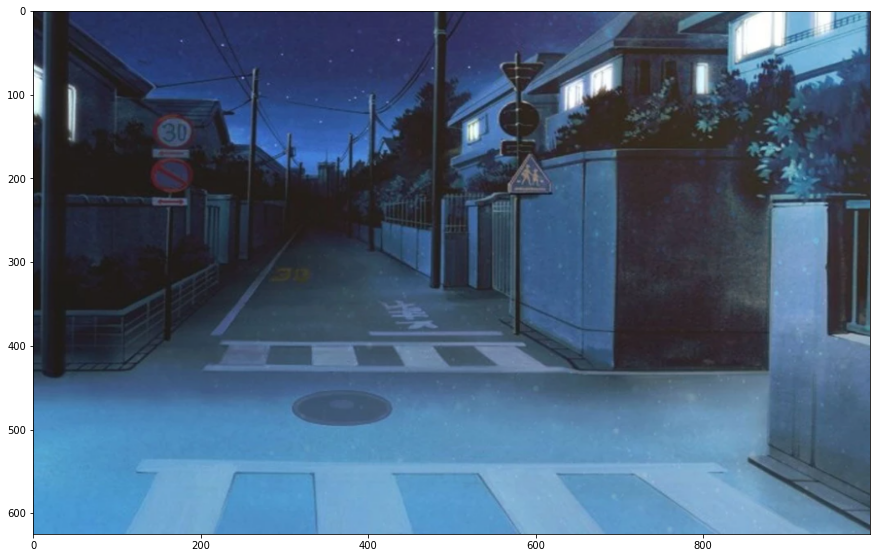

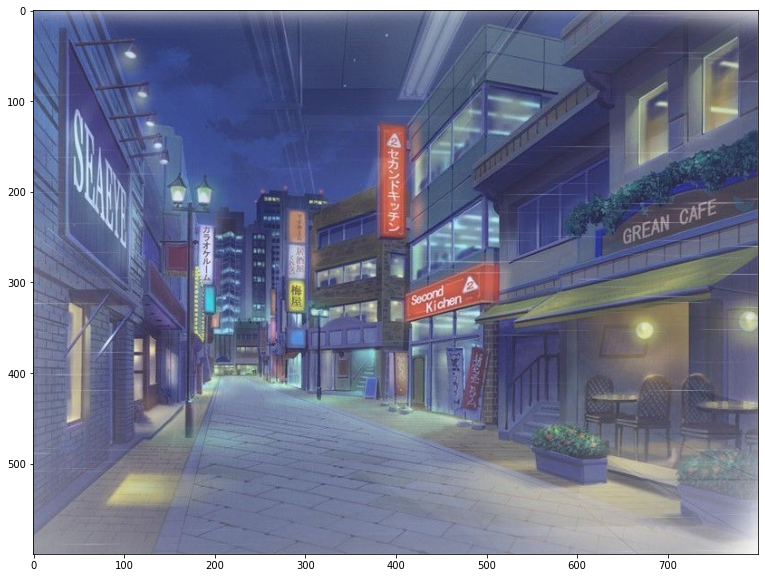

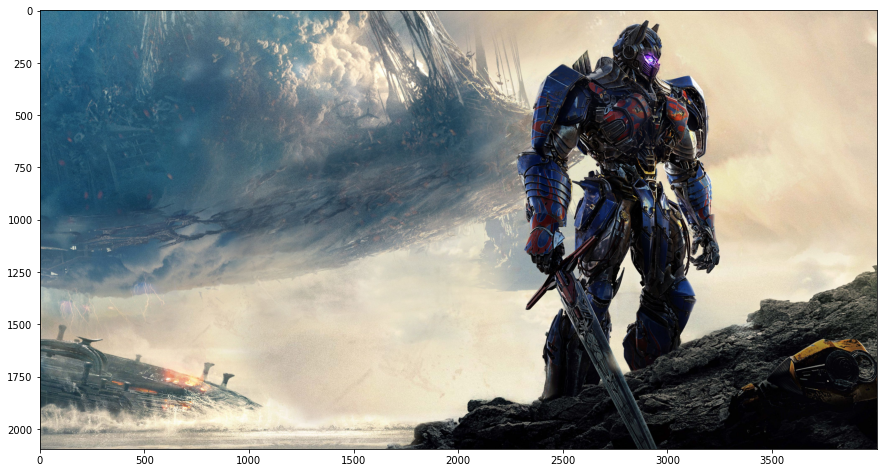

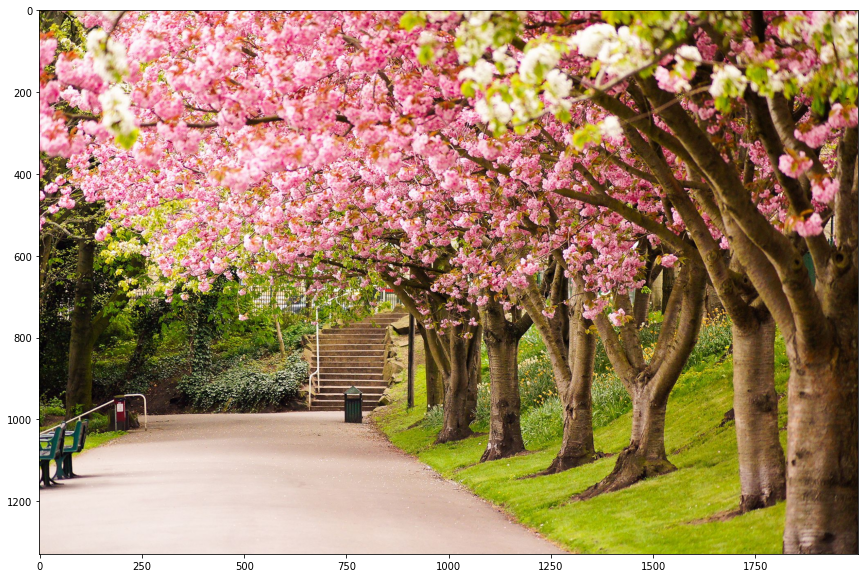

In [ ]:
# Show bg images
for image in bg_img_lst:
    plt.figure(figsize=(15, 10))
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.show()

###### Some Analysis:

1. For Carry, TOP-LEFT region is needed.
2. For ANime GiRL, `200 - 800` in x-axis is the region for clipping.
3. For Transformer, side green screens need to be cropped out.
4. Same goes for BULL-DOG.

In [ ]:
# required Cropping
fg_img_lst[0] = fg_img_lst[0][0:350, 0:450]
fg_img_lst[4] = fg_img_lst[4][:, 400:1000]
fg_img_lst[5] = fg_img_lst[5][:, 250:550]
for kk in range(1, 4):
    fg_img_lst[kk] = fg_img_lst[kk][:, 200:800]

###### Some essential image-preprocessing

Enter the Image Transformation details for carry as foreground
Enter 1 if u want to change fg image size or else 0: 1
Enter what percentage of shortest dimension (excluding channel) of background image should be covered by foreground image: 40
Enter the distance percentage in x-direction for top-left of foreground image to be placed on background: 0
Enter the distance percentage in y-direction for top-left of foreground image to be placed on background: 0
Enter the Image Transformation details for anime as foreground
Enter 1 if u want to change fg image size or else 0: 1
Enter what percentage of shortest dimension (excluding channel) of background image should be covered by foreground image: 100
Enter the distance percentage in x-direction for top-left of foreground image to be placed on background: 50
Enter the distance percentage in y-direction for top-left of foreground image to be placed on background: 100
Enter the Image Transformation details for anime as foreground
Enter 1 if u 

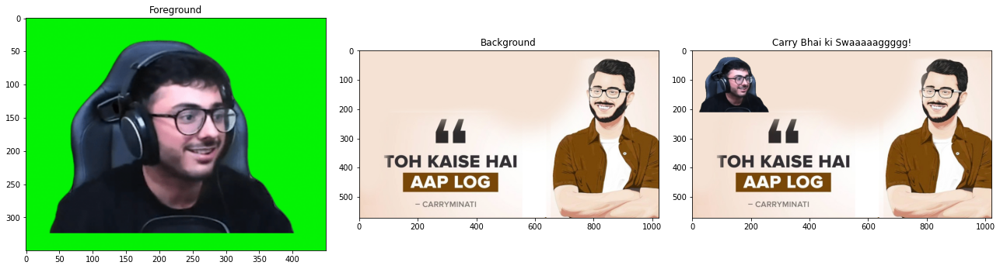

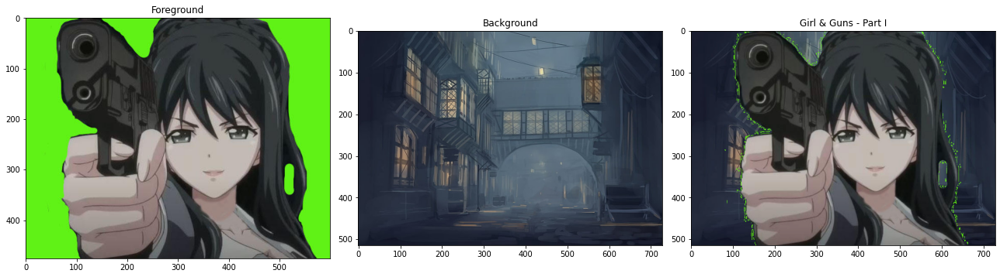

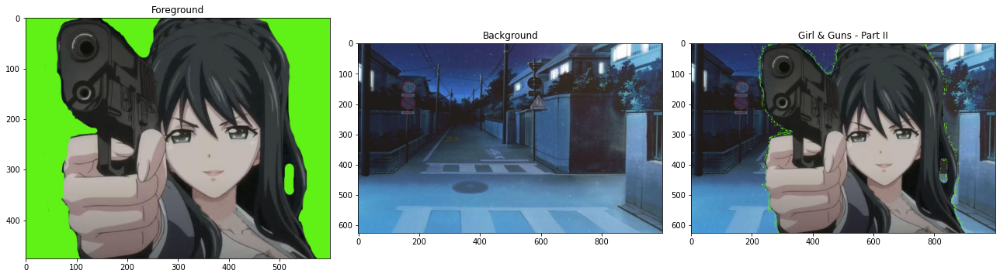

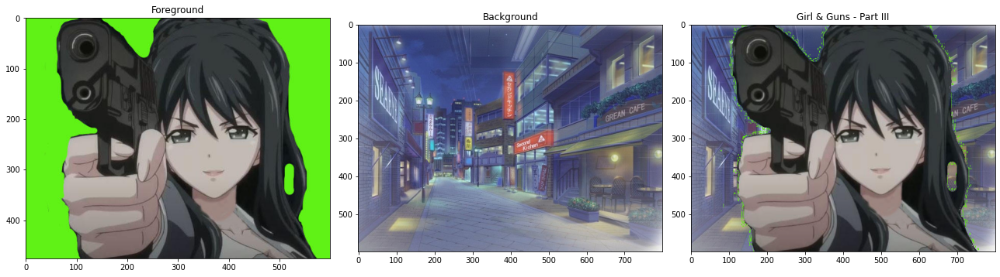

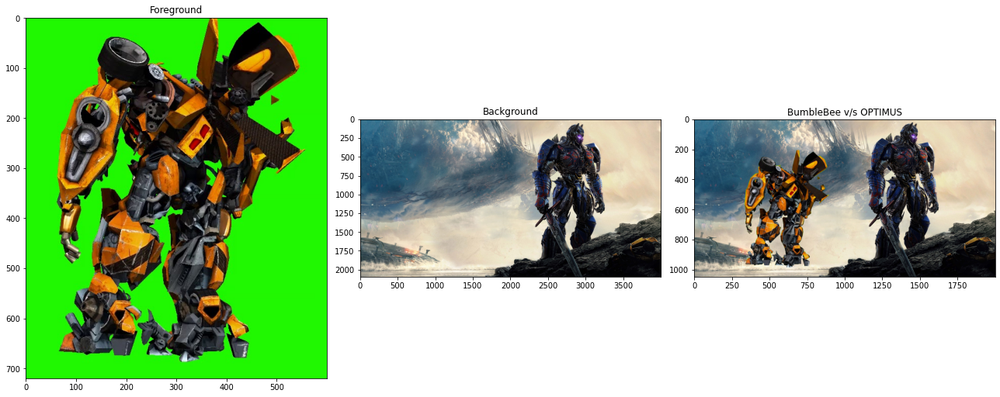

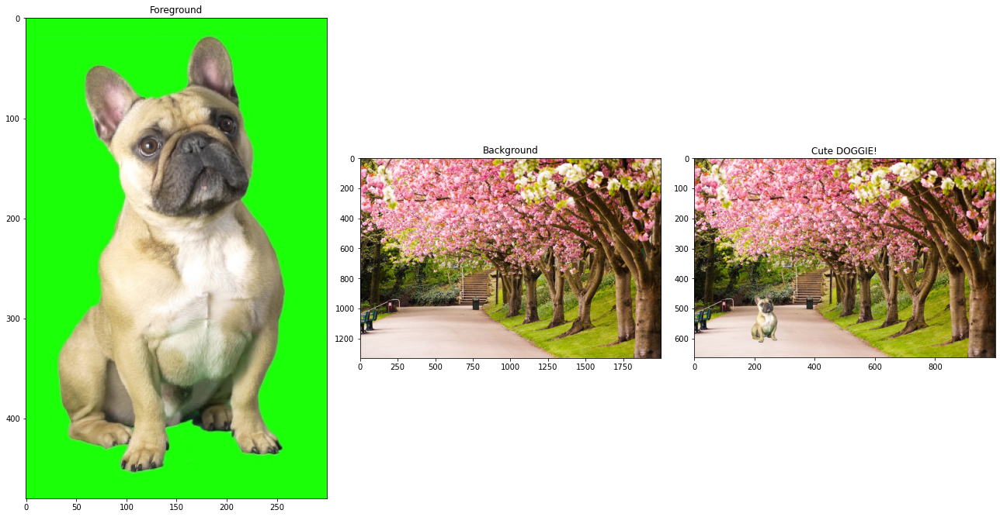

In [ ]:
# Now let's DO THE JOB!
background_transformer(fg_img_lst, fg_img_names, bg_img_lst, plot_names)

### Question 1.3

__Answer:__ 

Let's solve this question step-by-step.

1. Since images are of size $720 \times 576$, then total number of pixels in each image $ = 720 \times 576 = 414720$.
2. Since it can be shown on standard displays, we assume it to be __RGB images__ (with 3-channel depth) where each channel is __8-bit__ in nature. Hence, in-total it's a $8 \times \text{no. of channels} = 8 \times 3 = 24\text{-bit}$ image.
3. So each pixel can have $24$ possible values. So, _total bits_ for one image $ = 414720 \times 24 = 9953280$ bits, which is $9953280 / 8 = 1244160$ bytes (as __1 byte = 8 bits__)
4. Since we have $2$ GB storage (i.e. $2\times 2^{30}$ bytes), total no. of images we can store $ \leq \text{Available Storage}/\text{One Image Size} = \dfrac{2^{31}}{1244160} = 1726.05$. But as images are discrete quantities (i.e. __countable__), so in-total $\mathbf{1726}$ images can be stored in the cloud.

## Question 2

(10 points) __Colin’s Storage Issues__

Colin has just joined _hogwarts_ and brought a _muggle_ camera with him, He is very excited about all the magical things around him and wants to take many photos. But the problem, it has limited storage of $500$ MB. You, as his friend, have to help him by doing the following task. __Calculate the maximum dimensions of one image__ if colin wants
to take $200$ images back with him when he goes home for summer vacation. Assume all image shapes to be __squares__.

Colin is very curious and expects explanations for all the steps you take for the above task, so explain each step with theoretical details.

__Answer:__

__CASE I:__ _Muggle_ camera takes $8$-bit RGB pictures.

* In this case, we have $3$ channels per image. Let assume an image is of $p\times p$ resolution, then total  memory required in bits $ = p^{2} \times \text{no. of channels} \times \text{8} = 24p^{2}$.
* Since we have $200$ images, then total memory needed $ = 200 \times 24p^{2} = 4800p^{2}$ bits. Converting the same into bytes we get $ = \dfrac{4800p^{2}}{8} = 600p^{2}$ bytes.
* Now available storage is $500$ MB $ = 500 \times 2^{20}$ bytes. Storage of $200$ iamges should be limited within available space i.e, $600p^{2} \leq 500 \times 2^{20} = 5^{3}\times 2^{22}$, we have: $$\begin{align*}
\implies p^{2} &\leq \dfrac{5^{3} \times 2^{22}}{600} = 3.33 \times 2^{18} \\
\implies p &\leq \sqrt{3.33 \times 2^{18}} = 1.82 \times 2^{9} = 934.31
\end{align*}$$\
Rounding off $p$ to the greatest integer gives $p = 934$. Hence, _maximum_ dimension for RGB images should be $\mathbf{934}$.

__CASE II:__ _Muggle_ camera takes $8$-bit Gray-Scale pictures.

* In this case, we should divide the total memory taken by all our images by _no. of channels_. As gray-scale images have _one_ channel.
* So we have: $\dfrac{600p^{2}}{3} \leq 500 \times 2^{20} = 5^{3}\times 2^{22}$ $$\begin{align*}
\implies p^{2} &\leq \dfrac{5^{3}\times 2^{22}}{200} = 10 \times 2^{18} \\
\implies p &\leq \sqrt{10 \times 2^{18}} = \sqrt{10} \times 2^{9} = 1619.08
\end{align*}$$\
Rounding off $p$ to the greatest integer gives $p = 1619$. Hence, _maximum_ dimension for gray-scale images should be $\mathbf{1619}$.

## Question 3

(15 points) __Identifying the Basilisk__\
In the third installment of the Harry Potter franchise, there’s an obnoxious and destructive creature, the basilisk, on the loose. Whoever sees it directly with their naked eyes shall immediately succumb to death. Colin Creevey, a student at Hogwarts, used his camera to take a picture and the basilisk was inadvertently caught in the frame. He didn’t die as he looked at the evil entity indirectly, through his camera lens but was
stunned into petrification and his camera film was burned to a crisp as a result of the close impact.

You have been assigned the dangerous task of taking a photo of the basilisk so that it can be identified and eventually slain. The creature has extremely quick defences and you must take the picture from as far away as possible to avoid a lethal attack while also ensuring that the film is preserved and the photo isn’t rendered useless.

Your camera has a square CCD sensor of dimensions $10 \times 10$ mm with $1024 \times 1024$ pixels. Focal length of camera lens is equal to $43.5$ cm. You need to ensure that the target covers atleast $390$ pixels in height in the captured image. As long as you are at a distance of $240m$, you are safe from the basilisk. Calculate the height of the creature. Use markdown to show all the steps and give explanation for each step.

__Answer:__

* Since our camera is of square shape of dimension $10 \times 10$ $mm^{2}$, where we have $1024 \times 1024$ pixels, __pixels-per-mm__ $ = \dfrac{1024}{10} = 102.4$ pixels/$mm$.
* Focal-length $ = 43.5$ $cm$.
* Our target need to form an image that covers atleast $390$ pixels in height, which $ = \dfrac{390}{\text{pixels-per-mm}} = \dfrac{3900}{1024}$ $mm$.
* Our camera lens is at a distance of $240$ $m$ $ = 240 \times 10^{3}$ $mm$.
* Let, height of the basilisk $ = h$ $mm$, then equating the $\tan{}$ of two vertical angles, we get:
$$\begin{align*}
\tan{(\text{vertical angle 1})} &= \tan{(\text{vertical angle 2})}\\
\dfrac{height1}{base1} &= \dfrac{height2}{base2}\\
\dfrac{\text{height of image}/2}{\text{focal length}} &= \dfrac{\text{height of basilisk}/2}{\text{distance of lens from basilisk}}\\
\dfrac{3900/1024}{435} &\leq \dfrac{h}{240 \times 10^{3}}\quad\text{since, target need to cover atleast 390 pixels}\\
h &\geq 2101.3\text{ mm}\\
\end{align*}$$

Hence, the height of basilisk should be atleast $\mathbf{2101.3}$ $mm$ $ = \mathbf{2.101}$ $m$ to form an image of height atleast $390$ pixels on camera sensor.

## Question 4

(30 points) __Draco Strikes Again!__

Draco abhors all _muggle_ objects and naturally hates Colin’s camera. He took all the
images and corrupted them so Colin’s memories are ruined. Colin is devastated and
doesn’t trust anyone. You have to prove your skills to Colin and then help retrieve his
corrupted images.
1. Write a function `bitQuantizeImage` which takes an 8-bit image `im `and `k`, the number of bits to which the image needs to be quantized to and returns the $k$-bit quantized image. (10 points)
2. Colin wants see how good you are, so prove yourself by running the above function on __filch.jpg__ and find all 8-bits quantization results.
3. Furthermore he wants you to show all the bit planes of __hermoine.jpg__.
4. Now that you have gained the trust of Colin Help him guess the corruption procedure for a target _person’s_ image, __person corrupt.jpg__ The correct images that you know for that corresponding _person_ from Colin’s memory represented by __person.jpg__\
(Since my __roll no is 2021701010__, i.e., $2021701010 \mod 5 = 0$, I would be choosing __harry.jpg__ to help Colin guess the correct corruption procedure for __harry_corrupt.jpg__.)

### 4.1

`bitQunatizeImage`

In [6]:
def bitQuantizeImage(im, k):
    """
    Input:
        im: 8-bit image -- basically a gray-scale image
        k: required bit to which our present image would be transformed.
    Output:
        A k-bit image
    """
    assert np.issubdtype(
        im.dtype, np.integer
    ), "Floating point images are not allowed"  # np.issubdtype cover all types of integers.
    img = np.copy(im)
    if k > 8:  # Basically demanding for LEFT SHIFT operation
        return img * 2**(k - 8)
    elif k == 8:
        return im
    else:  # RIGHT SHIFT operation
        return (img // 2**(8 - k)).astype(np.uint8)

### 4.2

All $8$-bits qunatization results on __filch.jpg__.

In [3]:
# Convert this to 8-bit grayscale
def gray_conversion(im):
    """
    Input:
        im: RGB (3-channel) image
    Output:
        Gray-scale image
    """
    img = np.copy(im)
    return (0.2126 * img[:, :, 2] + 0.7152 * img[:, :, 1] + 0.0722 * img[:, :, 0]).astype(np.uint8)  # since BGR format

Filch image dimension = (250, 202, 3)
Filch image new dimension = (250, 202)


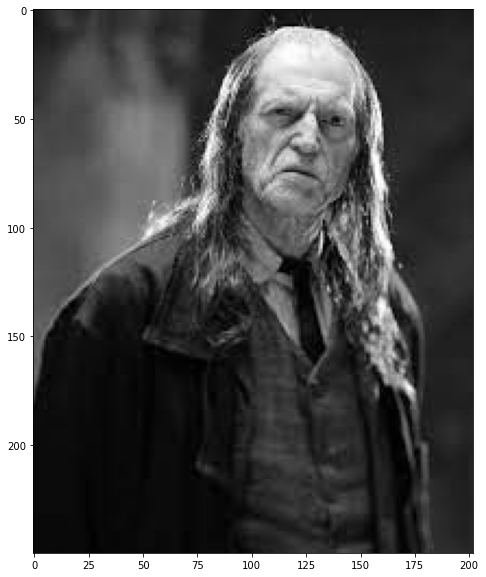

In [8]:
filch_im = cv2.imread(os.path.join(abs_path + "images", "filch.jpg"))
plt.figure(figsize=(15, 10))
plt.imshow(filch_im)
print(f"Filch image dimension = {filch_im.shape}")

#Alternative way to convert to gray: cv2.cvtColor(filch_im, cv2.COLOR_BGR2GRAY)
filch_im = gray_conversion(filch_im)
print(f"Filch image new dimension = {filch_im.shape}")

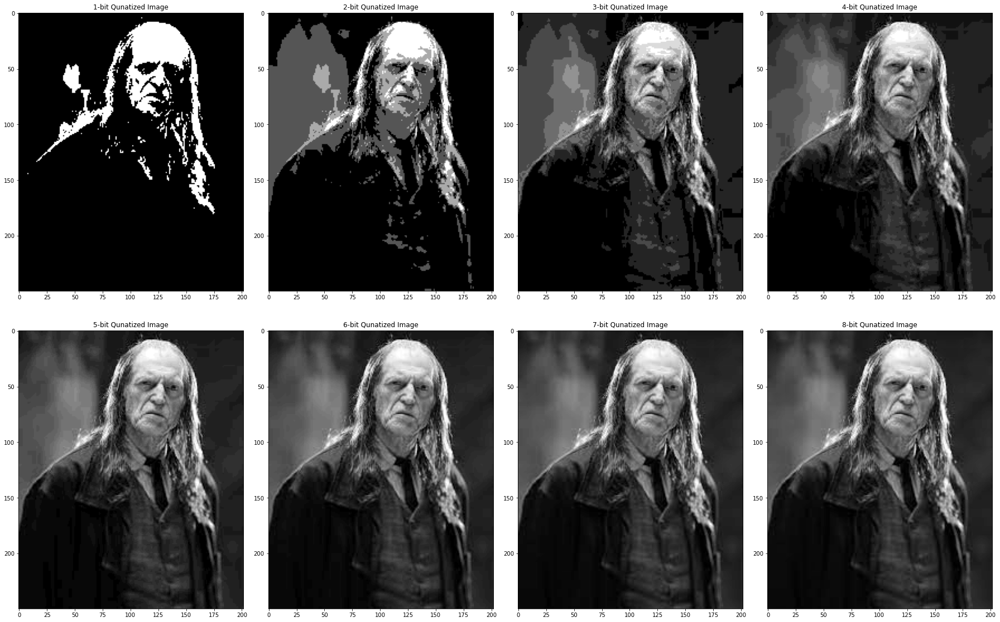

In [10]:
# Show all bit qunatized images
fig, ax = plt.subplots(nrows=2, ncols=4, figsize=(25, 17))
k = 1
for i in range(2):
    for j in range(4):
        ax[i, j].imshow(bitQuantizeImage(filch_im, k), cmap='gray')#, vmin = 0, vmax = 2**k
        ax[i, j].set_title(f"{k}-bit Qunatized Image")
        k += 1
fig.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

### 4.3

Bit Planes of __hermoine.jpg__.

In [35]:
def bitPlaneSlicing(img):
    """
    Input:
        img: An 8-bit image to be bit-sliced
    Output:
        8 binary images & Plots of those images
    """
    str_lst = []
    for i in range(img.shape[0]):
        for j in range(img.shape[1]):
            # Store the 8-bit width binary representation of each pixel value row-wise in a list.
            str_lst.append(np.binary_repr(img[i][j], width=8))
    # First bit plane = An Eight-bit image = Most Significant Bit (MSB); Pixel-values = first-bit-plane * 2^(8-1)
    eight_bit_img = (np.array([int(i[0]) for i in str_lst], dtype=np.uint8) *
                     128).reshape(img.shape[0], img.shape[1])
    # Second bit plane = A Seven-bit image; Pixel-values = second-bit-plane * 2^(8-2)
    seven_bit_img = (np.array([int(i[1]) for i in str_lst], dtype=np.uint8) *
                     64).reshape(img.shape[0], img.shape[1])
    # Third bit plane = A Six-bit image; Pixel-values = third-bit-plane * 2^(8-3)
    six_bit_img = (np.array([int(i[2]) for i in str_lst], dtype=np.uint8) *
                   32).reshape(img.shape[0], img.shape[1])
    # Fourth bit plane = A Five-bit image; Pixel-values = fourth-bit-plane * 2^(8-4)
    five_bit_img = (np.array([int(i[3]) for i in str_lst], dtype=np.uint8) *
                    16).reshape(img.shape[0], img.shape[1])
    # Fifth bit plane = A Four-bit image; Pixel-values = fifth-bit-plane * 2^(8-5)
    four_bit_img = (np.array([int(i[4]) for i in str_lst], dtype=np.uint8) *
                    8).reshape(img.shape[0], img.shape[1])
    # Sixth bit plane = A Three-bit image; Pixel-values = sixth-bit-plane * 2^(8-6)
    three_bit_img = (np.array([int(i[5]) for i in str_lst], dtype=np.uint8) *
                     4).reshape(img.shape[0], img.shape[1])
    # Seventh bit plane = A Two-bit image; Pixel-values = seventh-bit-plane * 2^(8-7)
    two_bit_img = (np.array([int(i[6]) for i in str_lst], dtype=np.uint8) *
                   2).reshape(img.shape[0], img.shape[1])
    # Last bit plane (eighth bit plane) = An One-bit image = Least Significant Bit (LSB); Pixel-values = last-bit-plane * 2^(8-8)
    one_bit_img = (np.array([int(i[7]) for i in str_lst], dtype=np.uint8) *
                   1).reshape(img.shape[0], img.shape[1])
    # Store them in a list:
    all_bits = [
        eight_bit_img, seven_bit_img, six_bit_img, five_bit_img, four_bit_img,
        three_bit_img, two_bit_img, one_bit_img
    ]
    # Show all bit qunatized images
    fig, ax = plt.subplots(nrows=2, ncols=4, figsize=(20, 15))
    k = 0
    for i in range(2):
        for j in range(4):
            ax[i, j].imshow(all_bits[k], cmap = "gray", vmin = 0, vmax = 2**(7-k))#, origin='lower' invert image 'gray', interpolation='none'
            ax[i, j].set_title(f"{8-k}-bit Image")
            k += 1
    fig.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()
    return all_bits

Shape of Hermoine image = (597, 323, 3)
Shape of Hermoine image, after gray-scale transformation = (597, 323)


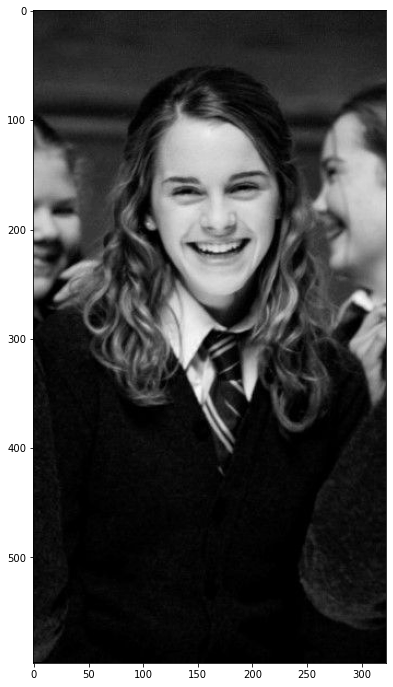

In [12]:
hermoine = cv2.imread(os.path.join(abs_path + "images", "hermoine.jpg"))
print(f"Shape of Hermoine image = {hermoine.shape}")

# conver to gray-scale
hermoine = gray_conversion(hermoine)
print(
    f"Shape of Hermoine image, after gray-scale transformation = {hermoine.shape}"
)
plt.figure(figsize=(18, 12))
plt.imshow(hermoine, interpolation = None, cmap="gray")
plt.show()

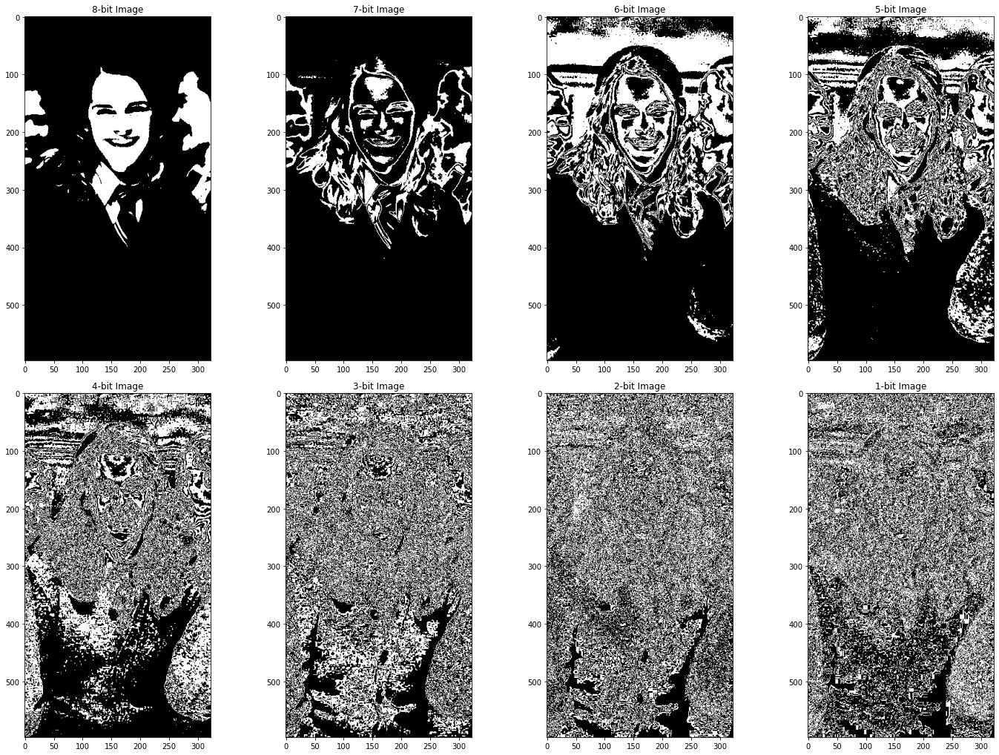

In [13]:
# Bit Plane Slicing
_ = bitPlaneSlicing(hermoine)

### 4.4

__Corruption procedure for harry.jpg__

In [28]:
# Read harry.jpg and harry_corrupt.jpg from the folder images
harry_im = cv2.imread(abs_path + "images/harry.jpg")
harry_corrupt_im = cv2.imread(abs_path + "images/harry_corrupt.jpg")
print(f"The Shape of Harry and it's corrupted version are {harry_im.shape} and {harry_corrupt_im.shape}, respectively.")

The Shape of Harry and it's corrupted version are (667, 1000, 3) and (667, 1000, 3), respectively.


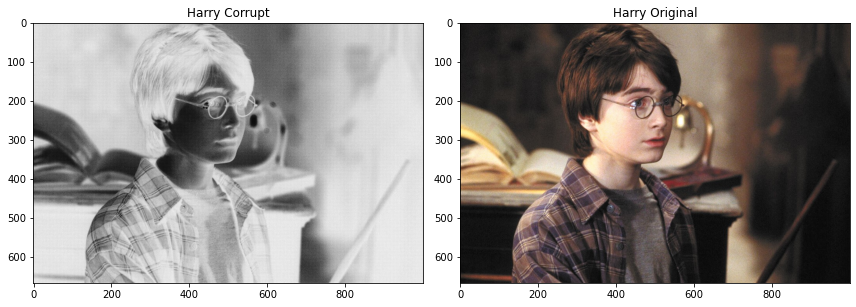

In [29]:
#View the Corrupt and Original versions.
fig,ax = plt.subplots(nrows = 1, ncols = 2, figsize =(12,18))
ax[0].imshow(harry_corrupt_im, cmap = "gray", interpolation = None); ax[0].set_title("Harry Corrupt")
ax[1].imshow(cv2.cvtColor(harry_im, cv2.COLOR_BGR2RGB)); ax[1].set_title(f"Harry Original")
fig.tight_layout(rect = [0, 0, 1, 0.95])
plt.show()

#### GUESS 1: Take Gray-Scale version of Original and perform negative operation to see if it is same as the corrupted one and along with that try to plot histogram of both.

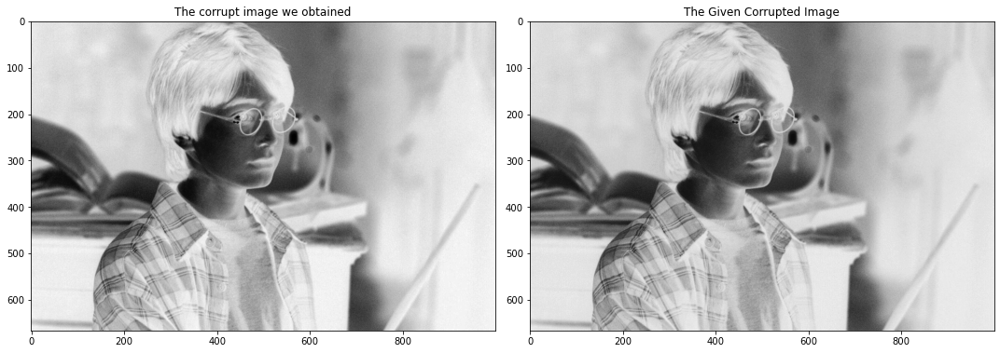

In [30]:
#Step 1: Convert to Gray-Scale version
harry_gray = gray_conversion(harry_im)
#Step 2: Obtain the negative of gray-Scale version
harry_corrupt_guess1 = 255 - harry_gray
# Visualize
fig, ax = plt.subplots(nrows = 1, ncols = 2, figsize = (15, 15))
ax[0].imshow(harry_corrupt_guess1, 'gray', interpolation=None, vmin=0.0, vmax=255)
ax[0].set_title("The corrupt image we obtained")

# Convert 3 channel-corrupted image to one channel
harry_corrupt_im = gray_conversion(harry_corrupt_im)
ax[1].imshow(harry_corrupt_im, cmap = 'gray', vmin=0, vmax=255)
ax[1].set_title("The Given Corrupted Image")
fig.tight_layout(rect = [0, 0, 1, 0.95]); plt.show()

__Corruption Procedure__

> `Original Image` ⟶ `Gray-Scale Image` ⟶ `Negative of Gray-Scale`

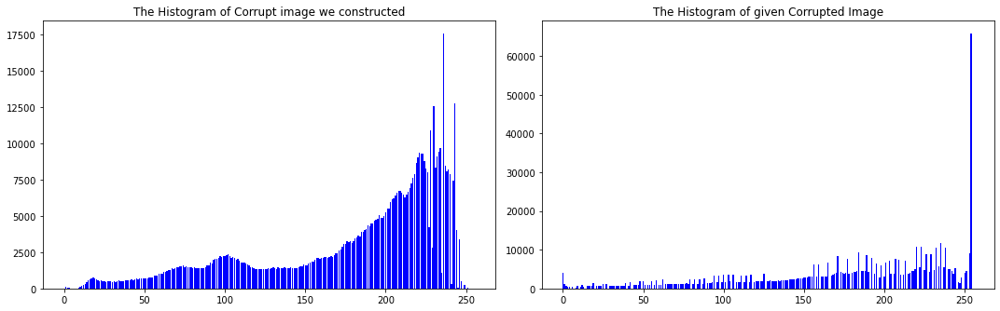

In [32]:
# Let's look at their Histogram
fig, ax = plt.subplots(nrows = 1, ncols = 2, figsize = (15, 5))
ax[0].bar(np.arange(256), pixel_freq(harry_corrupt_guess1, 8)[:, 1], color = 'blue')
ax[0].set_title("The Histogram of Corrupt image we constructed")
ax[1].bar(np.arange(256), pixel_freq(harry_corrupt_im, 8)[:, 1], color = 'blue')
ax[1].set_title("The Histogram of given Corrupted Image")
fig.tight_layout(rect = [0, 0, 1, 0.95]); plt.show()

## Question 5

(15 points) __Snape and The Order of The Phoenix__\
In the Harry Potter Saga, Snape is basically a double agent who appears to report to Voldemort initially. Severus Snape attends the highly confidential meetings of the _Order of the Phoenix_ at Number 12, Grimmauld Place. He infiltrates the group and sees all
the members of the Order. However the picture he has as proof is taken in very low light and saved as __phoenix-bad.jpg__.\
![Image](https://drive.google.com/uc?id=1CZFp10nHiaZ_EyQ5cYnKNmXJB2OOHlLK)\
As Snape you have the following tasks to convince the death eaters of your loyalty
towards them,
1. Write a function `linContrastStretching` which takes any image `im`, integers $a$ and $b$ that enhance the contrast such that the resulting intensity range is $[a, b]$.
2. Use the function to improve the intensity of __phoenix-bad.jpg__ and supposedly assist Voldemort.
3. Show the input image and the resultant image along with their __colorbars__ (a strip containing $k$ most frequently occurring colors). Give suitable explanation for the resulting colorbars.

Bellatrix wants you to be debriefed first just after your return. She has your wand and all high-level clearance passes on hold till then. Explain the improvement in the contrast theoretically, so that she releases your documents and you can carry on with your spying
assignment.

### 5.1

`linContrastStretching`

In [36]:
def linContrastStretching(im, a, b, version = 1, img_mode = "3C"):
    """
    Input:
        im: Input image
        a: lower bound of our resulting image's intensity interval
        b: upper bound of our resulting image's intensity interval
        version: 1 or 2; 1 for simple method and 2 for truncation method.
        img_mode: "3C" for 3-channel or "1C" for 1-channel
    Output:
        An Image whose intensity ranges in [a, b]
    """
    temp_im = np.copy(im)  # to prevent in -function changes to array.
    if img_mode == "3C":
        red_min, red_max, green_min, green_max, blue_min, blue_max = np.min(temp_im[:, :, 2]),\
        np.max(temp_im[:, :, 2]), np.min(temp_im[:, :, 1]), np.max(temp_im[:, :, 1]),\
        np.min(temp_im[:, :, 0]), np.max(temp_im[:, :, 0])
        if version == 1:
            slope_red, slope_green, slope_blue = (b - a) / (red_max - red_min),\
            (b - a) / (green_max - green_min), (b - a) / (blue_max - blue_min)
            # Transform RED channel
            temp_im[:, :, 2] = np.round((temp_im[:, :, 2] - red_min) * slope_red + a)
            # Transform GREEN channel
            temp_im[:, :, 1] = np.round((temp_im[:, :, 1] - green_min) * slope_green + a)
            # Transform BLUE channel
            temp_im[:, :, 0] = np.round((temp_im[:, :, 0] - blue_min) * slope_blue + a)
        elif version == 2:
            slow = eval(input("Enter by what % you want to trim pixel-axis from left: "))
            shigh = eval(input("Enter by what % you want to trim pixel-axis from right: "))
            red_range, blue_range, green_range = red_max - red_min, blue_max - blue_min, green_max - green_min
            # Redifining the range for RED channel
            red_hat_min, red_hat_max = round(red_min + (slow/100)*red_range + 1), round(red_max - (shigh/100)*red_range)
            # Redifining the range for GREEN channel
            green_hat_min, green_hat_max = round(green_min + (slow/100)*green_range + 1), round(green_max - (shigh/100)*green_range)
            # Redifining the range for BLUE channel
            blue_hat_min, blue_hat_max = round(blue_min + (slow/100)*blue_range + 1), round(blue_max - (shigh/100)*blue_range)
            # New slopes
            red_slope, blue_slope, green_slope = (b - a)/(red_hat_max - red_hat_min), (b - a)/(blue_hat_max - blue_hat_min),\
            (b - a)/(green_hat_max - green_hat_min)
            # define the intervals and coefficients for this piece-wise linear transform as we need to take care of pixels between
            # min and hat_min as well as hat_max and max
            coeffs_red, coeffs_green, coeffs_blue = [[0, a], [red_slope, (a - red_slope*red_hat_min)], [0, b]],\
            [[0, a], [green_slope, (a - green_slope*green_hat_min)], [0, b]],\
            [[0, a], [blue_slope, (a - blue_slope*blue_hat_min)], [0, b]]
            # intervals -- +1 at last piece of interval as to include the upper bound -- since a semi-closed interal
            intervals_red, intervals_green, intervals_blue = [[red_min, red_hat_min], [red_hat_min, red_hat_max], [red_hat_max, red_max + 1]],\
            [[green_min, green_hat_min], [green_hat_min, green_hat_max], [green_hat_max, green_max + 1]],\
            [[blue_min, blue_hat_min], [blue_hat_min, blue_hat_max], [blue_hat_max, blue_max + 1]]
            #print(f"RED Interval = {intervals_red}\nGREEN Interval = {intervals_green}\nBLUE Interval = {intervals_blue}")
            # Transform RED channel
            temp_im[:, :, 2] = piecewiseLinTransform(temp_im[:, :, 2], coeffs_red, intervals_red)
            # Transform GREEN channel
            temp_im[:, :, 1] = piecewiseLinTransform(temp_im[:, :, 1], coeffs_green, intervals_green)
            # Transform BLUE channel
            temp_im[:, :, 0] = piecewiseLinTransform(temp_im[:, :, 0], coeffs_blue, intervals_blue)
        else:
            raise ValueError("Ooops! Please Enter Correct Version. (Either 1 or 2)")
    elif img_mode == "1C":
        gray_min = np.min(temp_im); gray_max = np.max(temp_im)
        if version == 1:
            # Transform gray Channel
            temp_im = np.round((temp_im - gray_min) * ((b-a)/(gray_max-gray_min)) + a)
        elif version == 2:
            slow = eval(input("Enter by what % you want to trim pixel-axis from left: "))
            shigh = eval(input("Enter by what % you want to trim pixel-axis from right: "))
            gray_range = gray_max - gray_min
            # Redifining the range for RED channel
            gray_hat_min, gray_hat_max = round(gray_min + (slow/100)*gray_range + 1), round(gray_max - (shigh/100)*gray_range)
            # New slopes
            gray_slope = (b - a)/(gray_hat_max - gray_hat_min)
            # Coeffs
            coeffs_gray = [[0, a], [gray_slope, (a - gray_slope*gray_hat_min)], [0, b]]
            # Intervals
            intervals_gray = [[gray_min, gray_hat_min], [gray_hat_min, gray_hat_max], [gray_hat_max, gray_max + 1]]
            # Transform GRAY channel
            temp_im = piecewiseLinTransform(temp_im, coeffs_gray, intervals_gray)
        else:
            raise ValueError("Ooops! Please Enter Correct Version. (Either 1 or 2)")
        #num_pixels = temp_im.shape[0]*temp_im.shape[1]
    else:
        raise ValueError("Oops! Please Enter correct Image Mode.")
    return temp_im

### 5.2

Visualize Phoenix-Bad image (in LOW-LIGHT condition) in GOOD light condition

Shape of phoenix-bad = (410, 990, 3)


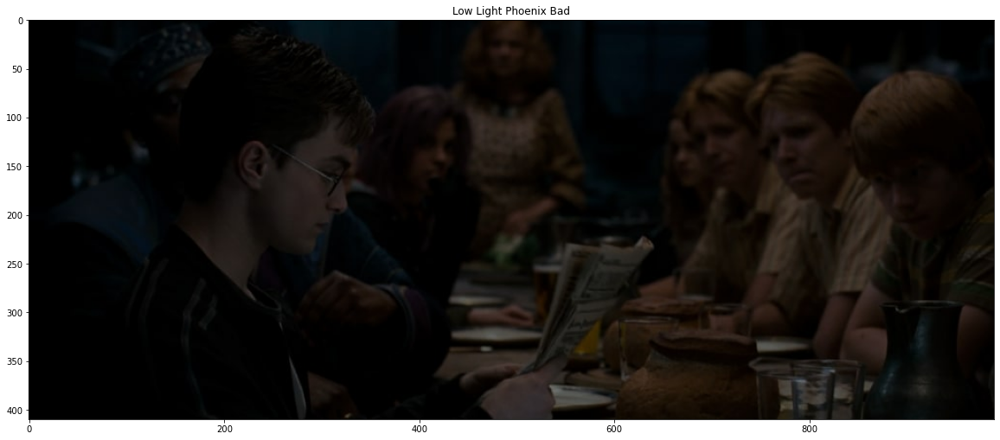

In [10]:
# Read phoenix-bad.jpg

phoenix_bad = cv2.imread(abs_path + "images/phoenix-bad.jpg")
print(f"Shape of phoenix-bad = {phoenix_bad.shape}")
plt.figure(figsize=(20, 25))
plt.imshow(cv2.cvtColor(phoenix_bad, cv2.COLOR_BGR2RGB))
plt.title('Low Light Phoenix Bad')
plt.show()

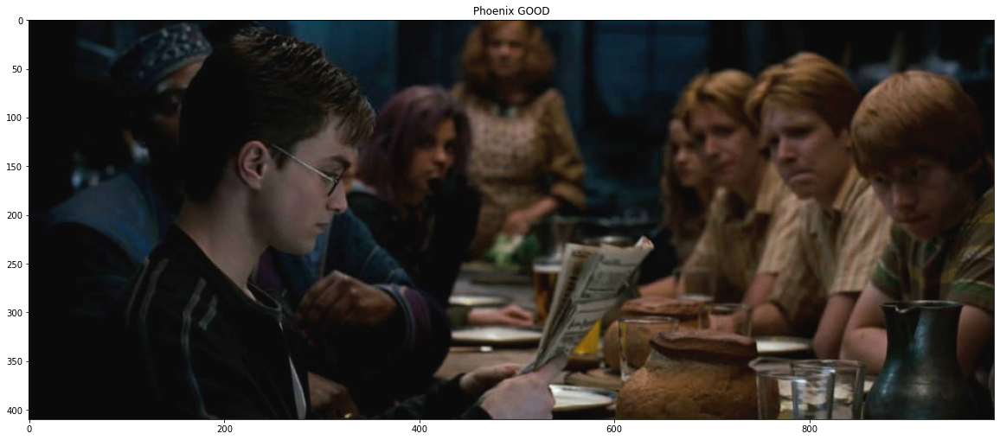

In [26]:
# Since we're doing CONTRAST Stretching ---> let's do it for interval [10, 255]
contrast_phoenix = linContrastStretching(phoenix_bad, 10, 255)
# Let's see the Result.
plt.figure(figsize=(20, 25))
plt.imshow(cv2.cvtColor(contrast_phoenix, cv2.COLOR_BGR2RGB))
plt.title('Phoenix GOOD'); plt.show()

Enter by what % you want to trim pixel-axis from left: 2.5
Enter by what % you want to trim pixel-axis from right: 2.5


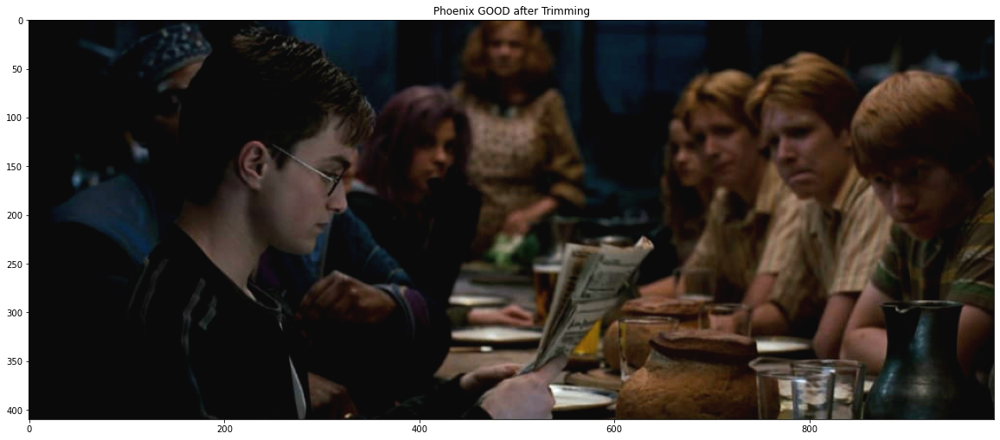

In [27]:
# Since we're doing CONTRAST Stretching ---> let's do it for interval [10, 255]
contrast_phoenix_trim = linContrastStretching(phoenix_bad, 10, 255, version = 2)
# Let's see the Result.
plt.figure(figsize=(20, 25))
plt.imshow(cv2.cvtColor(contrast_phoenix_trim, cv2.COLOR_BGR2RGB))
plt.title('Phoenix GOOD after Trimming'); plt.show()

### 5.3

`colorbar`

In [37]:
# helper functions

def arr_extract(colors_val):
    """
    Input:
        colors_val: a list of strings, where each string contains rgb color code
    Output:
        A list that contains lists of rgb triple values.
    """
    colors_arr = []
    for col in colors_val:
        colors_arr.append([np.uint8(ele) for ele in col.split("-")])
    return colors_arr


def pixel_freq_dict(im):
    """
    Input:
        im: Input Image whose pixel distribution is to be estimated.
    Output:
        Pixel distribution of the given image.
    """
    rgb_dict = {}
    for i in range(im.shape[0]):
        for j in range(im.shape[1]):
            rgb_pixel_str = "-".join([str(m)
                                      for m in im[i, j, :]][::-1])  # reversing
            if rgb_pixel_str in rgb_dict:
                rgb_dict[rgb_pixel_str] += 1
            else:
                rgb_dict[rgb_pixel_str] = 1
    return rgb_dict


def bar_plot(colors_val, colors_arr, rgb_dict, image_name):
    """
    Outputs a Bar Plot from the look-up table (a dictionary) on Frequency of pixel v/s pixel values.
    """
    # Create Bar Plot
    # Create bars with different colors
    x_pos = np.arange(len(colors_val))
    height = [rgb_dict[ele] for ele in colors_val]
    plt.figure(figsize=(22, 8))
    # define c-map
    cmap = mlp.colors.LinearSegmentedColormap.from_list("my_cmap",
                                                        colors=colors_arr,
                                                        N=len(colors_val))
    plt.bar(x_pos, height, color=colors_arr)
    # Create names on the x-axis
    plt.xticks(x_pos, colors_val, rotation=90)
    plt.title(image_name)
    # Normalizer
    norm = mlp.colors.Normalize(vmin=0, vmax=1)
    # creating ScalarMappable
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])
    cbar = plt.colorbar(sm)  #, ticks = colors_val
    #func = lambda x: x.split("-")
    cbar.set_ticks(np.linspace(0, 1, len(colors_val)))
    cbar.set_ticklabels([
        f"R = {ele[0]}, G = {ele[1]}, B = {ele[2]}"
        for ele in arr_extract(colors_val)
    ])
    cbar.set_label("Color Strip")
    plt.show()


def colorbar(im, k, image_name):
    """
    Input:
        im: input image
        k: No. of most frequently occuring colors in the given Image
        image_name: name of Image for which color-bar is being drawn
    Output:
        A strip showing k most frequently occuring colors
    """
    # A dictionary whose keys are pixels and their values are it's frequency
    rgb_dict = pixel_freq_dict(im)
    # Sort k most frequent colors
    # Another method sorted(rgb_lst.items(), key=lambda x: x[1], reverse=True)[:k])
    colors_val = sorted(rgb_dict, key=rgb_dict.get, reverse=True)[:k]
    #return [[key, rgb_dict[key]] for key in sorted(rgb_dict, key=rgb_dict.get, reverse=True)[:k]]
    # Convert str format of colors to array format.
    colors_arr = [(col[0] / 255., col[1] / 255., col[2] / 255.) for col in arr_extract(colors_val)]
    # Show COLOR-strip
    bar_plot(colors_val, colors_arr, rgb_dict, image_name)

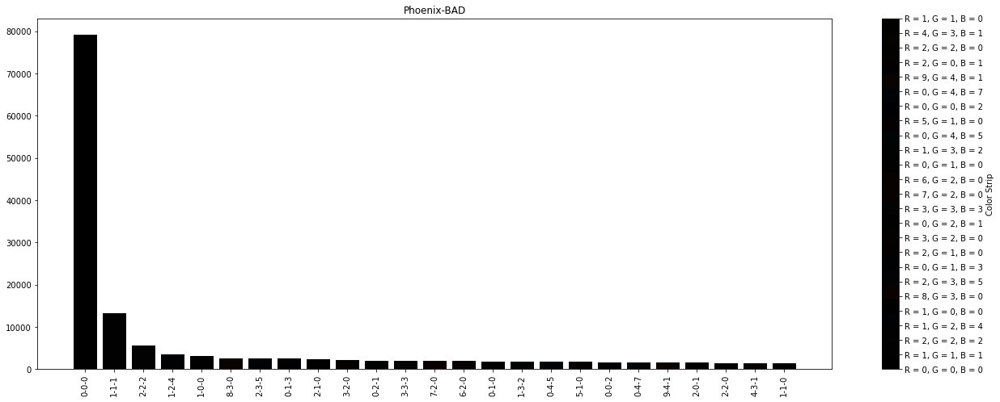

In [20]:
# For High Contrast Image
colorbar(phoenix_bad, 25, "Phoenix-BAD")

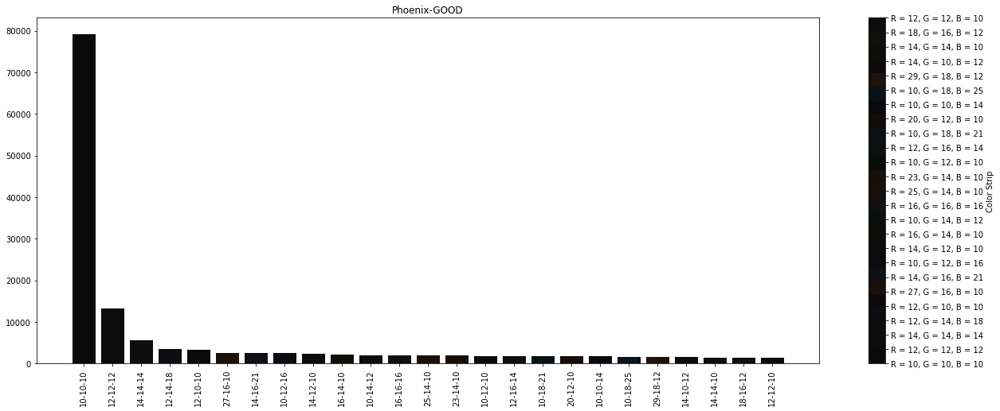

In [21]:
# For High Contrast Image
colorbar(contrast_phoenix, 25, "Phoenix-GOOD")

###### Explanation on why we get such HISTOGRAMS...

- In the original image, pixels (in order of R, G, & B) like $(0, 0, 0)$, $(1, 1, 1)$, $(2, 2, 2), \ldots$ and so on, have highest occurences (in decreasing fashion).
- Here we have performed `Linear Contrast Stretching`, i.e., basically applying a linear equation ($y = mx + c$) to the given pixels. And as the contrast stretching demands the function to be increasing, that specifies `m` in $y = mx + c$ should be __positive__, making this equation a strictly increasing continuous function. This means each pixel in the spatial domain (of the original image) is uniquely mapped to some pixel such that this transformed pixel has no other pre-images except the one mentioned ( = one-one mapping).
- So, for each channel (as we have RGB image), we have three different linear equations, say $$\begin{align*}
y_{1} &= m_{1}x_{1} + c_{1},\ \text{for channel R}\\
y_{2} &= m_{2}x_{2} + c_{2},\ \text{for channel G}\\
y_{3} &= m_{3}x_{3} + c_{3},\ \text{for channel B}
\end{align*}$$then, $$\begin{align*}
(0,0,0) &\longrightarrow (c_{1}, c_{2}, c_{3})\\
(1,1,1) &\longrightarrow (m_{1} + c_{1}, m_{2} + c_{2}, m_{3} + c_{3})\\
(2,2,2) &\longrightarrow (2m_{1} + c_{1}, 2m_{2} + c_{2}, 2m_{3} + c_{3})\ \text{and so on.}
\end{align*}$$
- And since our $c_{1} = c_{2} = c_{3} = 10$ and $m_{1} = m_{2} = m_{3} = 2$, $$\begin{align*}
(0,0,0) &\stackrel{\text{replaced by}}{\longrightarrow} (10,10,10)\\
(1,1,1) &\stackrel{\text{replaced by}}{\longrightarrow} (12,12,12)\\
(2,2,2) &\stackrel{\text{replaced by}}{\longrightarrow} (14,14,14)\ \text{and so on.}
\end{align*}$$
- Hence, the counts for $(10, 10, 10)$, $(12, 12, 12)$, $(14, 14, 14), \ldots$ and so on would be the same as we have seen for $(0, 0, 0)$, $(1, 1, 1)$, $(2, 2, 2), \ldots$ and rest.

### Okay! Bellatrix I'll explain WHY the Contrast improved?

- The contrast of an image depends upon the varieties of pixels used to color that image or, say, the range of color palettes we use. For a better contrast image, our pixel values must come from a more comprehensive support/ domain (e.g., $[0, 255]$ for $8$-bit images) where each pixel is equally likely to be in the picture.
- Now, what we did here was just an application of domain stretching through a linear transformation (or simply a line). We took the actual range $= (max_{intensity} - min_{intensity})$ and scaled it to the range $[10, 255]$. As a result, our image now contains pixel samples that more or less represent the range $[10, 255]$, thereby enhancing the contrast.
- __Note__: _Always drastic/ considerable intensity changes are more eye-catching and give more details to an image than smoother changes where different intensities are comparable._

## Question 6

(30 points) __Hermoine and linear transforms__\
_Hermoine_ came across a new spell in her potions class that is used to transform the gray level of the image. She _for the first time_ is not able to understand the topic! and she has an assignment due today.\
You have to help her in her assignment-
1. Write a function `piecewiseLinTransform` to implement a piecewise linear transform $$\begin{equation}g(z) = K_{1}^{i} · z + K_{2}^{i};\ a^{i} \leq z \leq b^{i}\tag{1}
\end{equation}$$
The function takes an input grayscale image, coefficients $K_{1}, K_{2}$ and intervals $[a, b]$ for each linear segment and produces the transformed output image.
2. Run the images through `piecewiseLinTransform` on `snape1.jpg` and `hagrid.jpg`. The piecewise linear functions to be used are given for each image.

Actual Image  |  Required Transformation
:-------------------------:|:-------------------------:
![Image](https://drive.google.com/uc?id=1nUAjKm_Ozc675zJhwOwRu8q_T9_Ck_Kz) | ![Image](https://drive.google.com/uc?id=1J-vSO2zy5QUT2aYa5-gL5sv1XPyAFLoW)
![Image](https://drive.google.com/uc?id=1IZL2yAZtsIAi80t_220j8-qZRWGUoMms) | ![Image](https://drive.google.com/uc?id=1QKizm2zcQeCWOoIy2JaBHSJpB5ArRSab)

3. Take your photo, convert to grayscale, and run `piecewiseLinTransform` using any custom piecewise linear function that you like. Plot the function used.

Even after your demonstration _Hermoine_ didn’t understand. So, explain all the steps that you performed in detail.

***

### 6.1

`piecewiseLinTransform`

In [38]:
def interval_index(the_no, intervals_lst):
    """
    Input:
        the_no: The number for which we need to return in which interval it lies
        intervals_lst: list of all intervals
    Output:
        The Interval
    """
    i = 0
    for interval in intervals_lst:
        if interval[0] <= the_no < interval[1]:
            return interval, i
        #else: continue or print(f"The interval = {interval}")
        i += 1
    #print(f"The no = {the_no}.")
    raise ValueError("Oops! That was not a valid input. Try again...")


def piecewiseLinTransform(im, coeffs, intervals):
    """
    Input:
        im: gray_scale image
        coeffs: list of lists -- two coeffs in a list
        intervals: list of intervals for each pair of coeffs
    Output:
        Transformed Image  
    """

    img = np.copy(im)  # prevent changes in orig array when call by reference is happening
    for i in range(img.shape[0]):
        for j in range(img.shape[1]):
            _, int_idx = interval_index(im[i][j], intervals)
            img[i][j] = np.uint8(coeffs[int_idx][0] * img[i][j] + coeffs[int_idx][1])
    return img

### 6.2

Transform `snape1.jpg` and `hagrid.jpg`

In [64]:
# Let's Transform the Gray-Scale Image.
snape_im = gray_conversion(cv2.imread(abs_path + "images/snape1.jpg"))
hagrid_im = gray_conversion(cv2.imread(abs_path + "images/hagrid.jpg"))

Shape of Snape Image =  (438, 780)


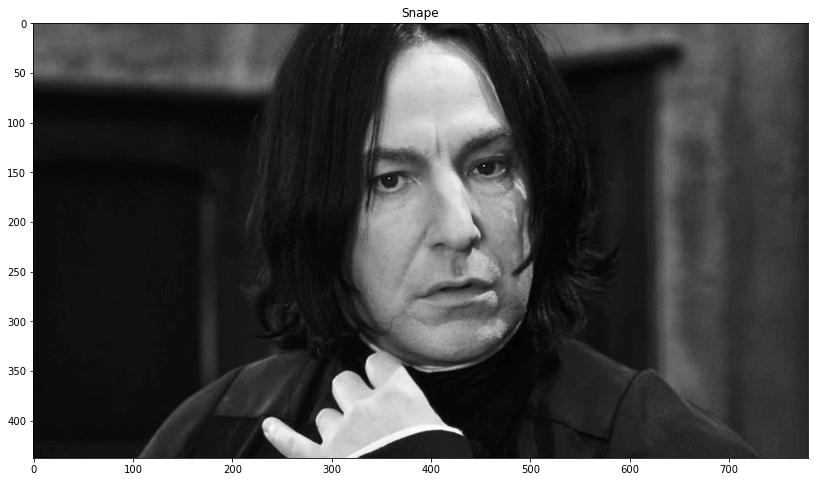



Shape of Hagrid Image =  (400, 533)


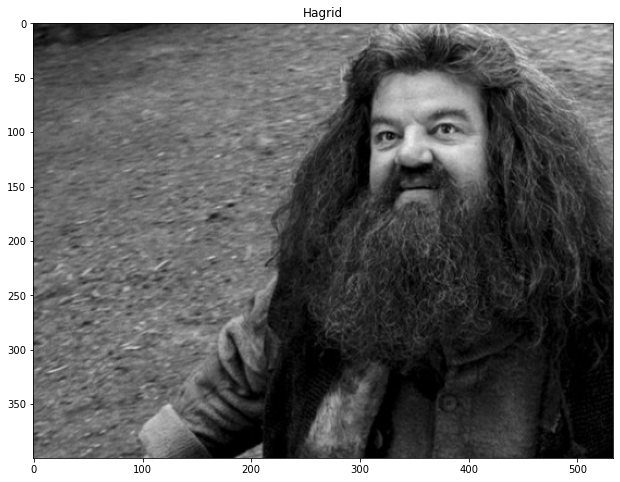

In [65]:
# SNAPE
print("Shape of Snape Image = ", snape_im.shape)
plt.figure(figsize=(18, 8))
plt.imshow(snape_im, cmap="gray")
plt.title("Snape")
plt.show()
# HAGRID
print("\n\nShape of Hagrid Image = ", hagrid_im.shape)
plt.figure(figsize=(18, 8))
plt.imshow(hagrid_im, cmap="gray")
plt.title("Hagrid")
plt.show()

In [66]:
# Let's break down the equation of graph for SNAPE and HAGRID into COEEFS and INTERVALS
snape_coeffs = [[9/2, 0], [-9, 765], [9/2, -382.5], [-9, 1530], [9/2, -765], [-9, 2295]]
snape_intervals = [[0, 57], [57, 85], [85, 142], [142, 170], [170, 227],
                   [227, 256]]
hagrid_coeffs = [[0, 0], [0, 56], [7, -340], [-7, 850], [0, 56], [0, 0]]
hagrid_intervals = [[0, 29], [29, 57], [57, 85], [85, 114], [114, 142],
                    [142, 255]]

In [67]:
# Apply pieceWiseLinearTransform()
snape_transformed = piecewiseLinTransform(snape_im, snape_coeffs,
                                          snape_intervals)
hagrid_transformed = piecewiseLinTransform(hagrid_im, hagrid_coeffs,
                                           hagrid_intervals)

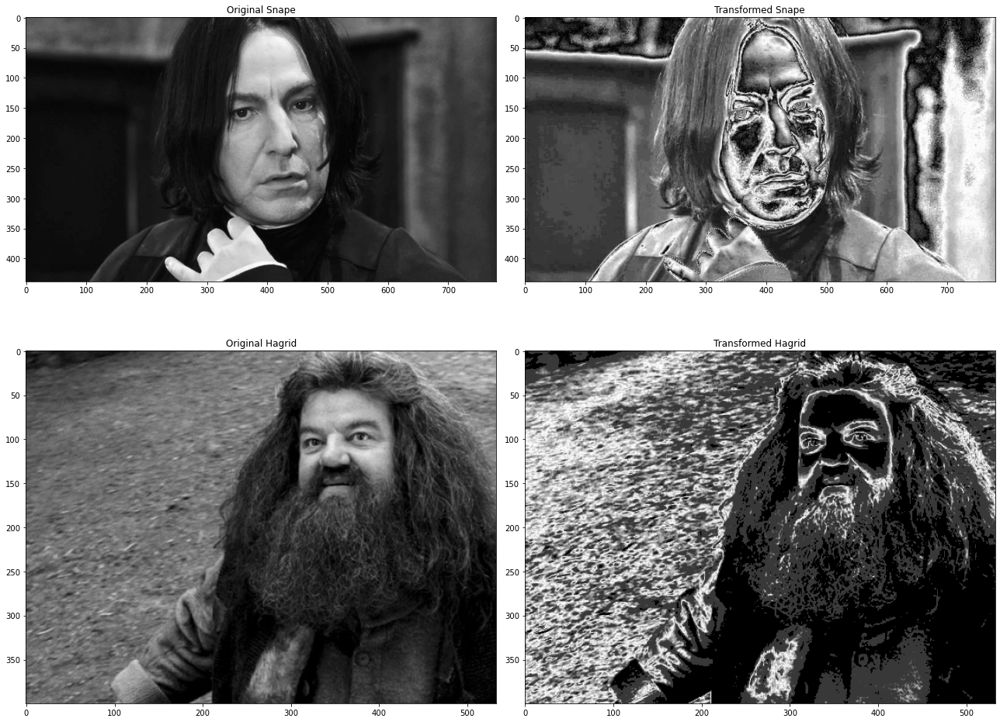

In [68]:
fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(18, 15))
ax[0, 0].imshow(snape_im, cmap="gray")
ax[0, 0].set_title("Original Snape")
ax[0, 1].imshow(snape_transformed, cmap="gray")
ax[0, 1].set_title("Transformed Snape")
ax[1, 0].imshow(hagrid_im, cmap="gray")
ax[1, 0].set_title("Original Hagrid")
ax[1, 1].imshow(hagrid_transformed, cmap="gray")
ax[1, 1].set_title("Transformed Hagrid")
fig.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

### 6.3

Transform MYSELF

Shape of MY Image =  (4000, 6000)


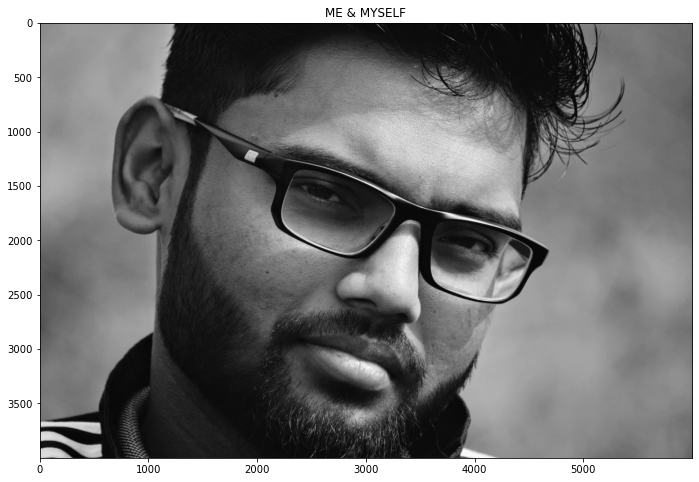

In [51]:
my_im = gray_conversion(cv2.imread(abs_path + "images/me.jpg"))
print("Shape of MY Image = ", my_im.shape)
plt.figure(figsize=(18, 8))
plt.imshow(my_im, cmap="gray")
plt.title("ME & MYSELF")
plt.show()

In [53]:
# coefficients and their corresponding intervals for MY IMAGE
my_coeffs = [[15 / 4, 0], [-10, 701.25], [5, -255], [0, 127.5], [5, -382.5],
             [-5, 892.5], [0, 63.75], [10, -1848.75], [-15 / 4, 956.25]]
my_intervals = [[0, 51], [51, 64], [64, 77], [77, 102], [102, 128], [128, 153],
                [153, 192], [192, 204], [204, 255]]
# Apply the required transformations
my_transformed = piecewiseLinTransform(my_im, my_coeffs, my_intervals)

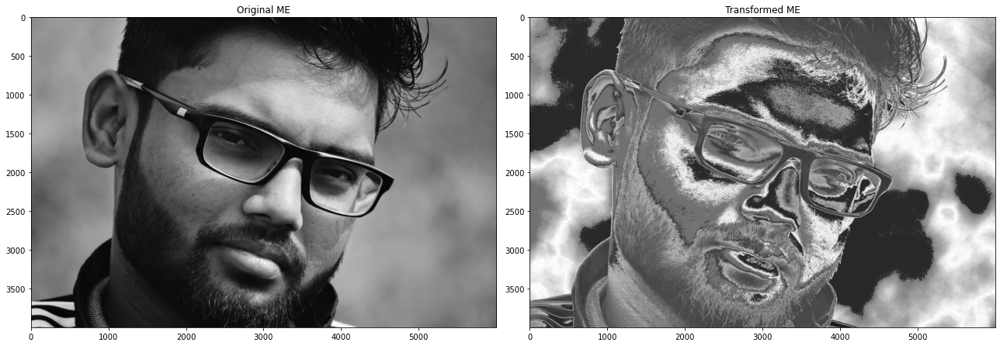

In [54]:
# Let's see our Transformed Counterpart
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(18, 15))
ax[0].imshow(my_im, cmap="gray")
ax[0].set_title("Original ME")
ax[1].imshow(my_transformed, cmap="gray")
ax[1].set_title("Transformed ME")
fig.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

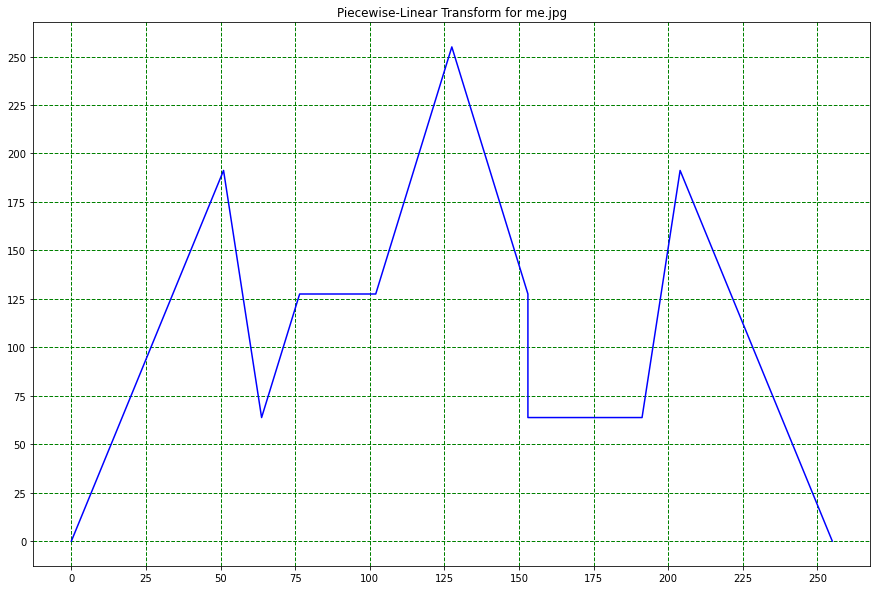

In [62]:
# Let's plot the function we have used.
x_vals = [0, 51, 63.75, 76.5, 102, 127.5, 153, 153, 191.25, 204, 255]
y_vals = [0, 191.25, 63.75, 127.5, 127.5, 255, 127.5, 63.75, 63.75, 191.25, 0]
plt.figure(figsize=(15, 10))
plt.plot(x_vals, y_vals, 'b-'); plt.title("Piecewise-Linear Transform for me.jpg")
plt.xticks(np.arange(0, 256, 25)); plt.yticks(np.arange(0, 256, 25))
plt.grid(color = 'green', linestyle = '--', linewidth = 1); plt.show()

### Let's understand the whole process we done above together _Hermoine_.

Functions used: `piecewiseLinTransform()`, `interval_index()`, `gray_conversion()`

Steps:
1. We imported `snape1.jpg` and `hagrid.jpg` and converted them to a one-channel gray-scale format using `gray_coversion()`.
2. Pass those images along with a set of coefficients for piece-wise line equations and their corresponding intervals in exact order (in `list` format) into `piecewiseLinTransform()`. For each image, we ran a `for` loop through each pixel from top-left (the origin of an image) to right-bottom.
3. Pass that pixel value to `interval_index()` to obtain the interval that contains these values. And correspondingly, pick out the coefficient set that describes the piece-wise line in that interval.
4. Do the operation, $g(z) = \text{coeffs}[0]z + \text{coeffs}[1]$, where $g(z) = $ transformed pixel from $z$.
5. Repeated __3__ and __4__ until we reach that image's bottom-right.

## Question 7

(30 points) __The Marauder’s Map__\
In the series, Harry has been given the Marauder’s Map by Fred and George Weasley. He happens to spot some fishy symbols on the map when Lupin suddenly confiscates it from him. He is only left with an image file named map.jpeg. To explain the bizarre turn of events to Lupin, Harry needs to act fast and try to decipher the images he saw
quickly.\
He needs to put his Digital Image Processing skills to use for retrieving this informa-
tion. Since this is a covert operation, you will __NOT__ be using any inbuilt functions for implementing the histogram processing operations.
* Write a function `histEqualization` which takes a grayscale image `img`, and applies histogram equalization on the entire image.
* Apply the function on `fred.jpeg` and display the input image and the resultant image. Plot the histograms for input and resultant image and explain the changes you observe for each image.
* Write a function `histMatching` which takes an input image and a reference image and applies histogram matching on the input image by matching the histogram with that of the reference image.
* Try histogram matching on `map.jpeg` and `map-reference.jpeg`.

### Question 7.1

`histEqualization`

In [39]:
def pixel_freq(im, bpp, prob = False):
    """
    Input:
        im: Image in form of an 2D array
        bpp: # of bits-per-pixel
        prob: A boolean that decides upon type of frequency output i.e., either probabilistic or integral.
    Output:
        Freuency of each pixel in the given image
    """
    freq_dict = {i:0 for i in range(2**bpp)}
    for i in im:
        for j in i:
            freq_dict[j] += 1
    tot_pixels = im.shape[0]*im.shape[1]
    if prob:
        return np.array([[k, (freq_dict[k]/tot_pixels)] for k in freq_dict])
    return np.array([[k, freq_dict[k]] for k in freq_dict])

In [40]:
def histEqualization(img, bpp, version = 1):
    """
    Input:
        img: A gray-scale image
        bpp: # of bits-per-pixel
        version: 1 or 2 
    Output:
        An image whose pixel's frequency distribution is approximately similar to UNIFORM distribution.
    """
    im = np.copy(img)# to avoid changes in original image
    freq_arr = pixel_freq(im, bpp, prob = True)
    if version == 1:
        for k in range(im.shape[0]):
            for j in range(im.shape[1]):
                im[k][j] = round((2**bpp - 1)*np.sum(freq_arr[:(img[k][j]+1), 1]))
    elif version == 2:
        cum_freq_arr = np.cumsum(freq_arr[:,1]); cdf_min = cum_freq_arr[np.argwhere(cum_freq_arr != 0)[0, 0]]
        for k in range(im.shape[0]):
            for j in range(im.shape[1]):
                im[k][j] = round((2**bpp - 1)*(cum_freq_arr[img[k][j]] - cdf_min)/(1 - cdf_min))
    else:
        raise ValueError("OOps! Please enter the Version Properly. It's either 1 or 2")
    return im

### Question 7.2

`histEqualization` on `fred.jpg`

Note that `cmap = "gray"` maps the `max` value in the image array to $255$ while the `min` is mapped to $0$ which is basically a linear contrast stretching.

Shape of Fred image = (480, 320, 3)


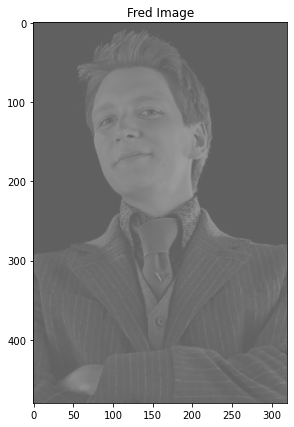

In [3]:
# Read fred.jpg
fred_im = cv2.imread(abs_path + "images/fred.jpeg")
print(f"Shape of Fred image = {fred_im.shape}")
plt.figure(figsize=(20, 7))
plt.imshow(fred_im); plt.title("Fred Image"); plt.show()

Since it is a __3__-channel image, we need to convert it to _ONE_ channel through gray-scale conversion.

In [6]:
# Conversion
fred_im_gray = gray_conversion(fred_im)
print(f"Shape of One-Channel Fred image = {fred_im_gray.shape}")

Shape of One-Channel Fred image = (480, 320)


In [10]:
# Apply histEqualization on fred_im_gray
version = 2
hist_equalized_fred = histEqualization(fred_im_gray, 8, version = version)

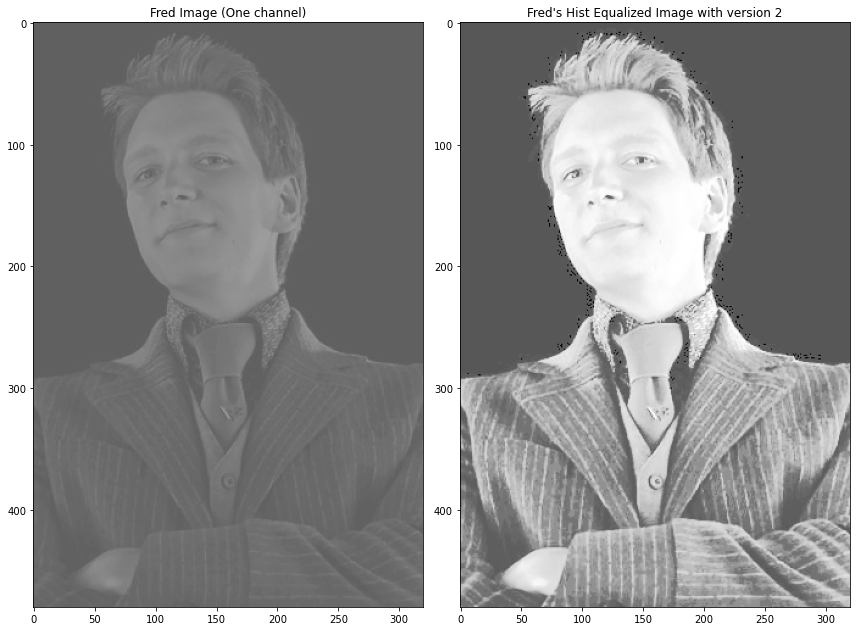

In [15]:
#Show the required images
fig,ax = plt.subplots(nrows = 1, ncols = 2, figsize =(12,18))
ax[0].imshow(fred_im_gray, cmap = "gray", vmin = 0, vmax = 255); ax[0].set_title("Fred Image (One channel)")
ax[1].imshow(hist_equalized_fred, cmap = "gray", vmin = 0, vmax = 255); ax[1].set_title(f"Fred's Hist Equalized Image with version {version}")
fig.tight_layout(rect = [0, 0, 1, 0.95])
plt.show()

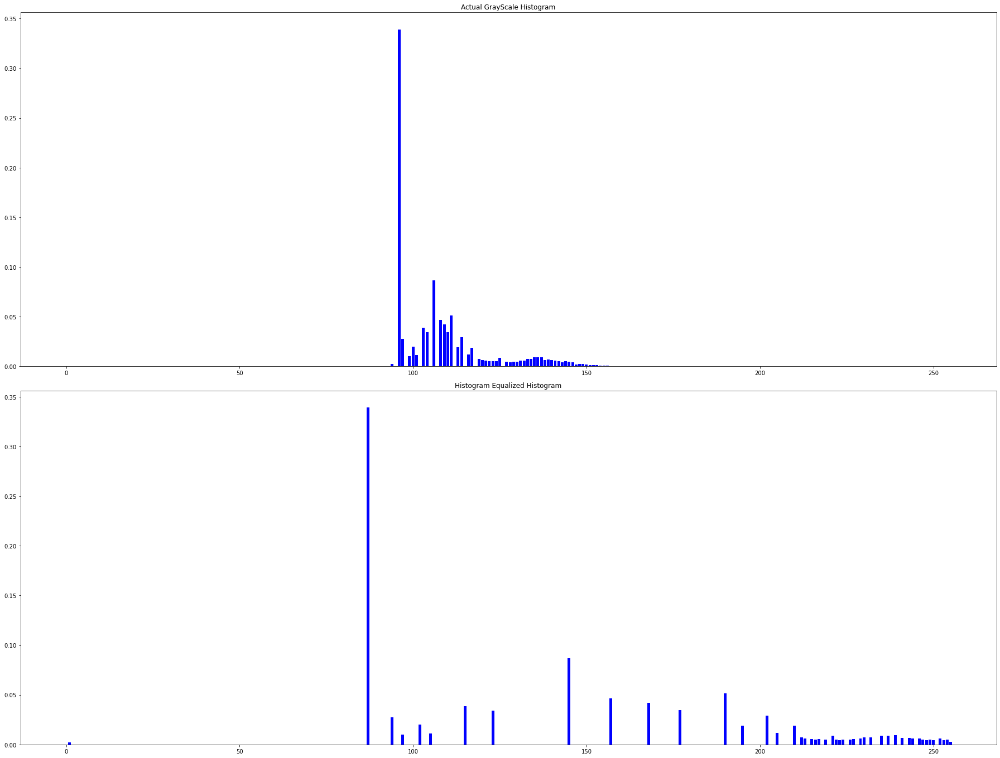

In [20]:
# histogram plots for both images -- GrayScale and Histogram Equalized
fig, ax = plt.subplots(nrows = 2, ncols = 1, figsize = (25, 20))
ax[0].bar(np.arange(256), pixel_freq(fred_im_gray, 8)[:, 1], color = "blue")
ax[0].set_title("Actual GrayScale Histogram")
ax[1].bar(np.arange(256), pixel_freq(hist_equalized_fred, 8)[:, 1], color = "blue")
ax[1].set_title("Histogram Equalized Histogram")
fig.tight_layout(rect = [0,0,1,0.95])
plt.show()

#### Changes we observed

* In `fred.jpeg`, most of the pixels are of mid-dark intensity (of range $[90, 125]$), and the rest are what we can comment as "white" pixels, albeit they don't look white, but relatively we can say so. And this is why the image looks dull and with minor detailing &ndash; "low contrast." 
* Since high-intensity pixels count is low, their contribution for histogram increment is not that significant due to which CDF increases at a slower pace in brighter pixels zone.
* This poses an advantage while performing `histEqualization()`, i.e., all brighter pixels cumulatively map to a single brighter(even more) pixel.
* E.g., Say, from $200$ to $255$ pixel range, the CDF increase from $0.99$ to $1$ in equal steps. Now $$
\begin{align*}
200 &\longrightarrow \text{round}\left[255 \times 0.99\right] = 252\\
201 &\longrightarrow \text{round}\left[255 \times \left(0.99 + \dfrac{0.01}{50}\right)\right] = 252\\
&\vdots\\
210 &\longrightarrow \text{round}\left[255 \times \left(0.99 + \dfrac{0.01 \times 10}{50}\right)\right] = 252\\
&\vdots\\
255 &\longrightarrow \text{round}\left[255 \times \left(0.99 + \dfrac{0.01 \times 50}{50}\right)\right] = 255
\end{align*}
$$.
* Though brighter pixel count is not much in the original image, which slowed the pace of histogram increment (i.e., $\frac{0.01}{50}$ at one-pixel value increment), in transformed image, the total count of $(200, \ldots, 210)$ together will be the count for $252$ which says that not only in our resultant image there will be __brighter pixels__, but also their __count would be comparable to other pixels__ thereby __enhancing the contrast__ of the whole image.
* And this is what we observed for transformed `fred.jpeg`.

### Question 7.3

`histMatching`

In [41]:
# helper function for histMatching

def dict_reversed(dictionary):
    """
    Input:
        dictionary: A dictionary
    Output:
        A reversed(value:key) dictionary
    """
    d = {dictionary[k]:k for k in list(dictionary.keys())[::-1]}
    return {k:d[k] for k in sorted(list(d.keys()))}#, reverse = True


def hist_equalize_map(im, bpp, inv = False, version = 2):
    """
    Input:
        im: Image whose histogram is to be obtained
        bpp: bits-per-pixel of the original image
        inv: Boolean indicating whether we need inverse dictionary mapping
        version: 1 or 2
    Output:
        A dictionary where keys are the original pixel intensity, while its corresponding values are the transformed intensity.
    """
    freq_arr = pixel_freq(im, bpp, prob = True)
    if version == 1:
        map_dict = {k:0 for k in range(2**bpp)}
        for m in range(2**bpp):
            map_dict[m] = round((2**bpp - 1)*np.sum(freq_arr[:(m+1), 1]))
        if inv: # we take the min of all pre-images in inverse mapping
            return dict_reversed(map_dict)
        return map_dict
    elif version == 2:
        cum_freq_arr = np.cumsum(freq_arr[:,1]); cdf_min = cum_freq_arr[np.argwhere(cum_freq_arr != 0)[0, 0]]
        map_dict = {k:0 for k in range(2**bpp)}
        for m in range(2**bpp):
            map_dict[m] = round((2**bpp - 1)*(cum_freq_arr[m] - cdf_min)/(1 - cdf_min))
        if inv: # we take the min of all pre-images in inverse mapping
            return dict_reversed(map_dict)
        return map_dict
    else:
        raise ValueError("Oops! Please enter the Version Properly. It's either 1 or 2")

def binary_search(lst, num, high, low):
    """
    Input:
        lst: The sorted list (in increasing order) where we need to search the given num
        num: The number whose location is to be searched
        high: Index of Last element in the list = len(lst) - 1
        low: Index of first element in the list
    Output:
        Index of Immediate upper and lower bound for the num.
    """
    # Check base case
    if high>=low:
        # Middle index.
        mid = (high+low)//2
        # If element is present at the middle itself
        if lst[mid] <= num < lst[mid + 1]:
            return mid
        # If element/number is larger than mid, then it can only be present in right subarray
        elif lst[mid + 1] < num:
            return binary_search(lst, num, high, mid+1)
        # Else the element can only be present in left subarray
        else:
            return binary_search(lst, num, mid, low)
    else:
        # Element is not present in the array
        return -1

    
def min_dist_ele(ref_key_lst, lower_bound_idx, num):
    """
    Input:
        ref_key_lst: keys of reference image mapping dictionary in ascending order
        lower_bound_idx: Index of the element in ref_key_lst which is immediately before num
        num: The Number whose neighbors are to be found
    Output:
        One element out of lower and upper bound of num        
    """
    if (ref_key_lst[lower_bound_idx] - num) < (ref_key_lst[lower_bound_idx + 1] - num):
        return ref_key_lst[lower_bound_idx]
    elif (ref_key_lst[lower_bound_idx] - num) == (ref_key_lst[lower_bound_idx + 1] - num):
        choice = np.random.randint(0,2)
        if choice == 0:
            return ref_key_lst[lower_bound_idx]
        else:
            return ref_key_lst[lower_bound_idx + 1]
    else:
        return ref_key_lst[lower_bound_idx + 1]
    
def g_inv_t(orig_im_hist_equalization_dict, ref_im_inv_hist_equalization_dict):
    """
    Input:
        orig_im_hist_equalization_dict: dictionary that maps original image's intensity to equalized histogram values.
        ref_im_inv_hist_equalization_dict: Dictionary that maps intensity of equalized histogram of reference image 
                                            to its corresponding pixel value in reference image.
    Output:
        A map (dictionary) that maps the original image's intensity to reference image's intensity such that 
        histogram of resultant image is approximately similar to the reference image.
    """
    orig_to_ref_dict = {}
    ref_key_lst = list(ref_im_inv_hist_equalization_dict.keys()); len_ref_lst = len(ref_key_lst)
    for key in orig_im_hist_equalization_dict:
        # If for T(r), there doesn't exist any k such that T(r) = G(k), then choose that k nearest to r
        #Or else if we're facing ties then choose the min.
        if orig_im_hist_equalization_dict[key] not in ref_im_inv_hist_equalization_dict:
            lower_bound_idx = binary_search(ref_key_lst, orig_im_hist_equalization_dict[key], (len_ref_lst - 1), 0)
            ref_pixel_val = min_dist_ele(ref_key_lst, lower_bound_idx, orig_im_hist_equalization_dict[key])
            orig_to_ref_dict[key] = ref_pixel_val
        else:
            orig_to_ref_dict[key] = ref_im_inv_hist_equalization_dict[orig_im_hist_equalization_dict[key]]
    return orig_to_ref_dict

# MAIN FUNCTION

def histMatching(orig_im, ref_im, bpp):
    """
    Input:
        orig_im: Original Image on which Histogram Matching is to be applied
        ref_im: The Image whose Histogram is used in matching process
        bpp: bits-per-pixel of the original image and reference image
    Output:
        A transformed original image whose pixel distribution is more/less same as reference image
    """
    tmp_img = np.copy(orig_im)
    # Obtain the mapping of original pixel to hist-equlaized pixels
    orig_im_hist_equalization_dict = hist_equalize_map(orig_im, bpp)
    #print(orig_im_hist_equalization_dict)
    # Obtain the mapping of reference image's pixel to hist-equlaized pixels
    ref_im_inv_hist_equalization_dict = hist_equalize_map(ref_im, bpp, inv = True)
    #print(ref_im_inv_hist_equalization_dict)
    # Replace the pixels of original image with G^(-1).T mapped pixels
    orig_to_ref_dict = g_inv_t(orig_im_hist_equalization_dict, ref_im_inv_hist_equalization_dict)
    # iterate through every pixels
    for i in range(orig_im.shape[0]):
        for j in range(orig_im.shape[1]):
            tmp_img[i][j] = orig_to_ref_dict[orig_im[i][j]]
    return tmp_img

###  Question 7.4

Histogram matching on `map.jpeg` and `map-reference.jpeg`.

In [132]:
# Read map.jpeg and map-reference.jpeg
map_im = cv2.imread(abs_path+"images/map.jpeg")
map_ref_im = cv2.imread(abs_path+"images/map-reference.jpeg")
print(f"Shape of MAP image = {map_im.shape}\nShape of MAP reference image = {map_ref_im.shape}")

Shape of MAP image = (1080, 1920, 3)
Shape of MAP reference image = (630, 1200, 3)


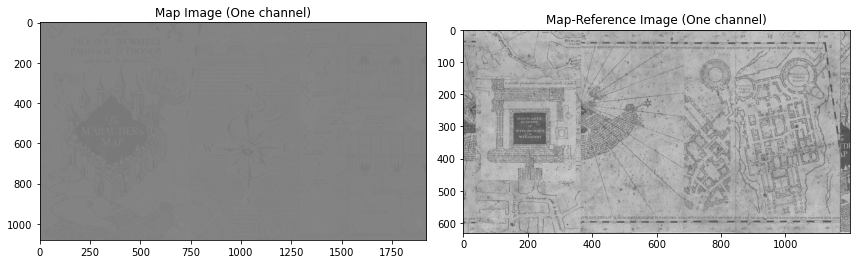

In [133]:
# Convert to one channel grayscale and view
map_gray_im = gray_conversion(map_im); map_ref_gray_im = gray_conversion(map_ref_im)
#Show the required images
fig, ax = plt.subplots(nrows = 1, ncols = 2, figsize =(12,18))
ax[0].imshow(map_gray_im, cmap = "gray", vmin = 0, vmax = 255); ax[0].set_title("Map Image (One channel)")
ax[1].imshow(map_ref_gray_im, cmap = "gray", vmin = 0, vmax = 255); ax[1].set_title("Map-Reference Image (One channel)")
fig.tight_layout(rect = [0, 0, 1, 0.95])
plt.show()

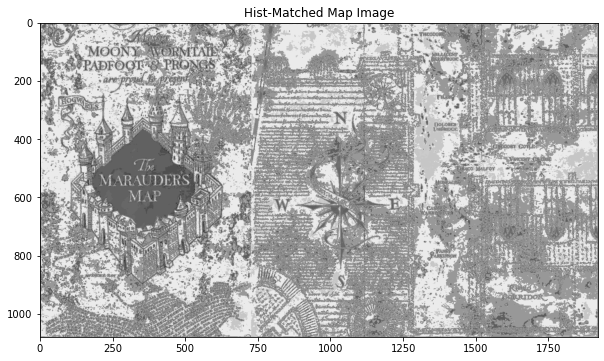

In [134]:
# Apply the transformation
hist_matched_im = histMatching(map_gray_im, map_ref_gray_im, 8)
# View the Image.
plt.figure(figsize = (10, 8))
plt.imshow(hist_matched_im, cmap = "gray", vmin = 0, vmax = 255); plt.title("Hist-Matched Map Image"); plt.show()

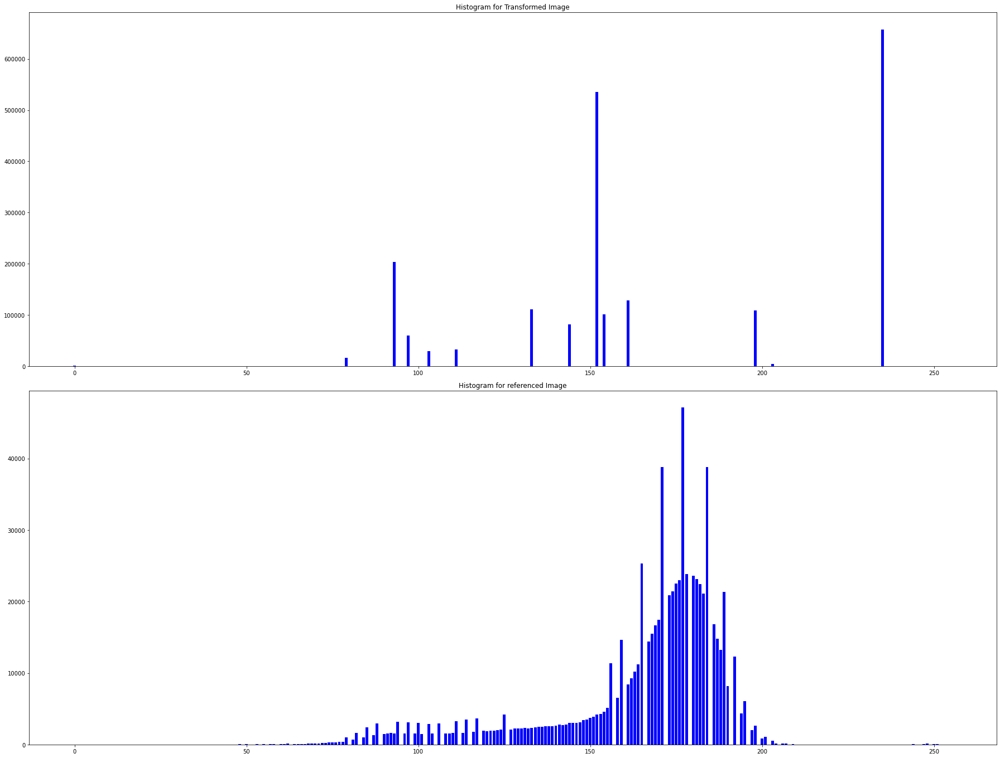

In [135]:
# Show Histogram of Both Transformed and Reference Image.
# histogram plots for both images -- GrayScale and Histogram Equalized
fig, ax = plt.subplots(nrows = 2, ncols = 1, figsize = (25, 20))
ax[0].bar(np.arange(256), pixel_freq(hist_matched_im, 8)[:, 1], color = "blue")
ax[0].set_title("Histogram for Transformed Image")
ax[1].bar(np.arange(256), pixel_freq(map_ref_gray_im, 8)[:, 1], color = "blue")
ax[1].set_title("Histogram for referenced Image")
fig.tight_layout(rect = [0,0,1,0.95])
plt.show()

## Question 8

(30 points) __The Seven Horcruxes__\
In Harry Potter and Half Blood Prince, Dumbledore and Harry set off to destroy one of Voldemort’s seven horcruxes. However it lies on a strip of land, in the middle of a dark cave, surrounded by water on all sides. The dark and treacherous waters need to be navigated with caution as they are home to the monstrous creatures, the inferi. Step up into the role of Dumbledore and use gamma transform to safely reach the isle and
carry out the important task.
* Write a function `gammaTransform` that implements $s = r^{\gamma}$ on a grayscale image and vary $\gamma$. Report your observations when $\gamma$ is less than 1 and when $\gamma$ is greater
than 1.
* Apply gamma transformation on `locket.jpeg` to increase the brightness in the
image. Report your observations.
* Apply gamma transformation on `voldemort.jpeg` to decrease the brightness in the
image. Report your observations.

### Question 8.1

`gammaTransform`

In [42]:
def gammaTransform(im, bpp, gamma):
    """
    Input:
        im: The gray-scale image to be transformed
        bpp: Bits-per-pixel of the gray-scale image
        gamma: The exponent to which all the normalized pixels are to be raised
    Output:
        Transformed Image
    """
    # Assert type of image to be Numpy Array or Not.
    if type(im) != np.ndarray:
        im = np.array(im)
    img = np.copy(im)
    # First scale the pixels between 0 and 1.
    img = img/(2**bpp - 1)
    # Apply Power $\gamma$ and then scale up to within interval [0, 255]
    return np.floor((img**gamma)*(2**bpp - 1))

### Question 8.2

Apply gamma transformation on `locket.jpeg`

In [99]:
# read locket.jpeg and transform it to gray scale if needed.
locket_im = cv2.imread(abs_path+"images/locket.jpeg")
print(f"Shape of Locket image = {locket_im.shape}")

Shape of Locket image = (1334, 774, 3)


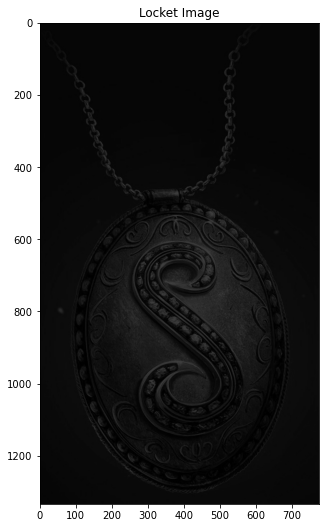

In [100]:
# Convert to one channel grayscale and view
locket_gray_im = gray_conversion(locket_im)
#Show the required image
plt.figure(figsize = (5, 10))
plt.imshow(locket_gray_im, cmap = "gray", vmin = 0, vmax = 255); plt.title("Locket Image"); plt.show()

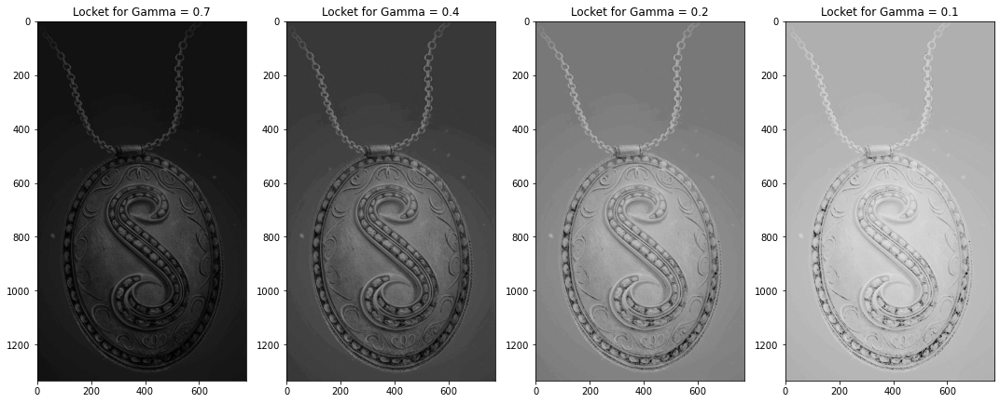

In [25]:
# Let's view images for each of the gamma in the below list
bright_gamma_lst = [0.7, 0.40, 0.20, 0.10]
images_locket = []
for gamma in bright_gamma_lst:
    images_locket.append(gammaTransform(locket_gray_im, 8, gamma))
fig, ax = plt.subplots(nrows = 1, ncols = len(bright_gamma_lst), figsize = (15, 18))
for i in range(len(bright_gamma_lst)):
    ax[i].imshow(images_locket[i], cmap = "gray", vmin = 0, vmax = 255)
    ax[i].set_title(f"Locket for Gamma = {bright_gamma_lst[i]}")
fig.tight_layout(rect = [0,0,1,0.95])
plt.show()

#### Observations

> As $\mathbf{\gamma}$ decreases from $\mathbf{1}$, the brightness increases since the lower valued pixels get mapped to the full range of intensities (e.g., $[0, 240]$), and the higher one remains as such.

### Question 8.3

Apply gamma transformation on `voldemort.jpeg`

In [26]:
# read locket.jpeg and transform it to gray scale if needed.
voldemort_im = cv2.imread(abs_path+"images/voldemort.jpeg")
print(f"Shape of Voldemort image = {voldemort_im.shape}")

Shape of Voldemort image = (667, 1200, 3)


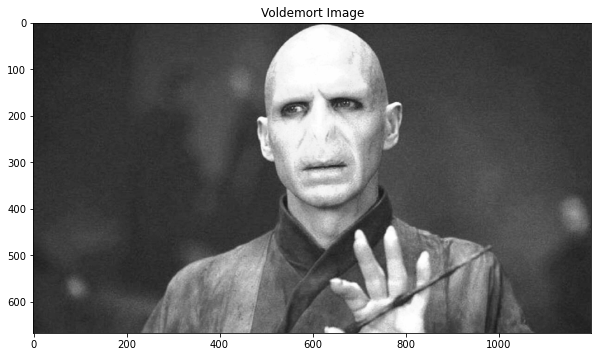

In [27]:
# Convert to one channel grayscale and view
voldemort_gray_im = gray_conversion(voldemort_im)
#Show the required image
plt.figure(figsize = (10, 8))
plt.imshow(voldemort_gray_im, cmap = "gray", vmin = 0, vmax = 255); plt.title("Voldemort Image"); plt.show()

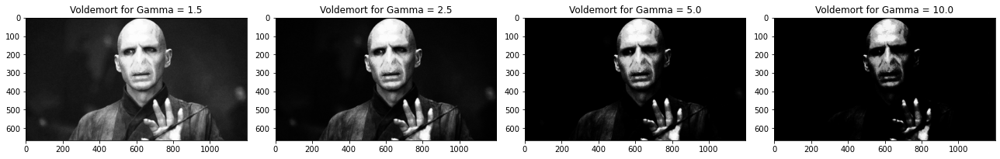

In [28]:
# Let's view images for each of the gamma in the below list
dark_gamma_lst = [1.5, 2.5, 5.0, 10.0]
images_voldemort = []
for gamma in dark_gamma_lst:
    images_voldemort.append(gammaTransform(voldemort_gray_im, 8, gamma))
fig, ax = plt.subplots(nrows = 1, ncols = len(dark_gamma_lst), figsize = (18, 20))
for i in range(len(dark_gamma_lst)):
    ax[i].imshow(images_voldemort[i], cmap = "gray", vmin = 0, vmax = 255)
    ax[i].set_title(f"Voldemort for Gamma = {dark_gamma_lst[i]}")
fig.tight_layout(rect = [0,0,1,0.97])
plt.show()

#### Observations

> While the case is reverse when $\mathbf{\gamma}$ increases above $\mathbf{1}$. Here, the brighter half of pixels (e.g., $L/2$ to $L-1$) get mapped to the full range, dimming some of the pixels at the left end (e.g., $L/2$ to $3L/4$) while lighting the ones at the right end. And the pixels in the lower half (e.g., $0$ to $L/2$) chose to stay in a darker zone where some of them might even get more dimmed/blackened (e.g., $L/4$ to $L/2$). 

## Question 9

(40 points) __Is that the best you got?__
1. You are provided with 4 grayscale images (`neville1.jpg`, `neville2.jpg`, `neville3.jpg`, `neville4.jpg`) with different contrast levels, which correspond to parts of the same image.
2. Retrieve the original image using these four images as best you can. You can use a combinations of techniques used in this assignment.
3. You will be evaluated on how uniform your final output looks. Clarity is not important as details are not present in the images. Use any of the above methods to achieve a common gray level as best you can.

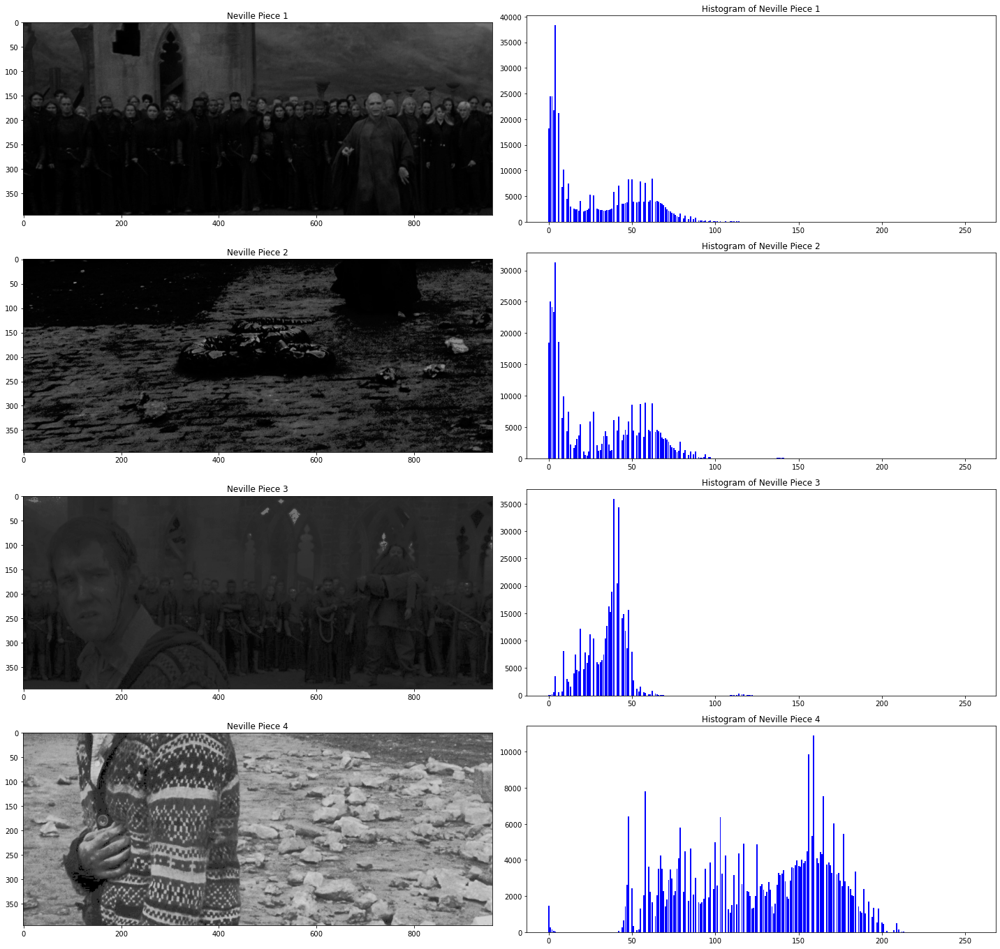

In [33]:
# Import all the images...
nevilles = [gray_conversion(cv2.imread(abs_path + f"images/neville{i}.jpg")) for i in range(1, 5)]
# Show each of them and their corresponding histogram...
fig, ax = plt.subplots(nrows = 4, ncols = 2, figsize = (20, 20))
for i in range(4):
    ax[i, 0].imshow(nevilles[i], cmap = "gray", vmin = 0, vmax = 255)
    ax[i, 0].set_title(f"Neville Piece {i+1}")
    ax[i, 1].bar(np.arange(256), pixel_freq(nevilles[i], 8)[:, 1], color = "blue")
    ax[i, 1].set_title(f"Histogram of Neville Piece {i+1}")
fig.tight_layout(rect = [0,0,1,0.95]); plt.show()

### TRIAL 1: Linear Contrast Stretching (Without Trimming)

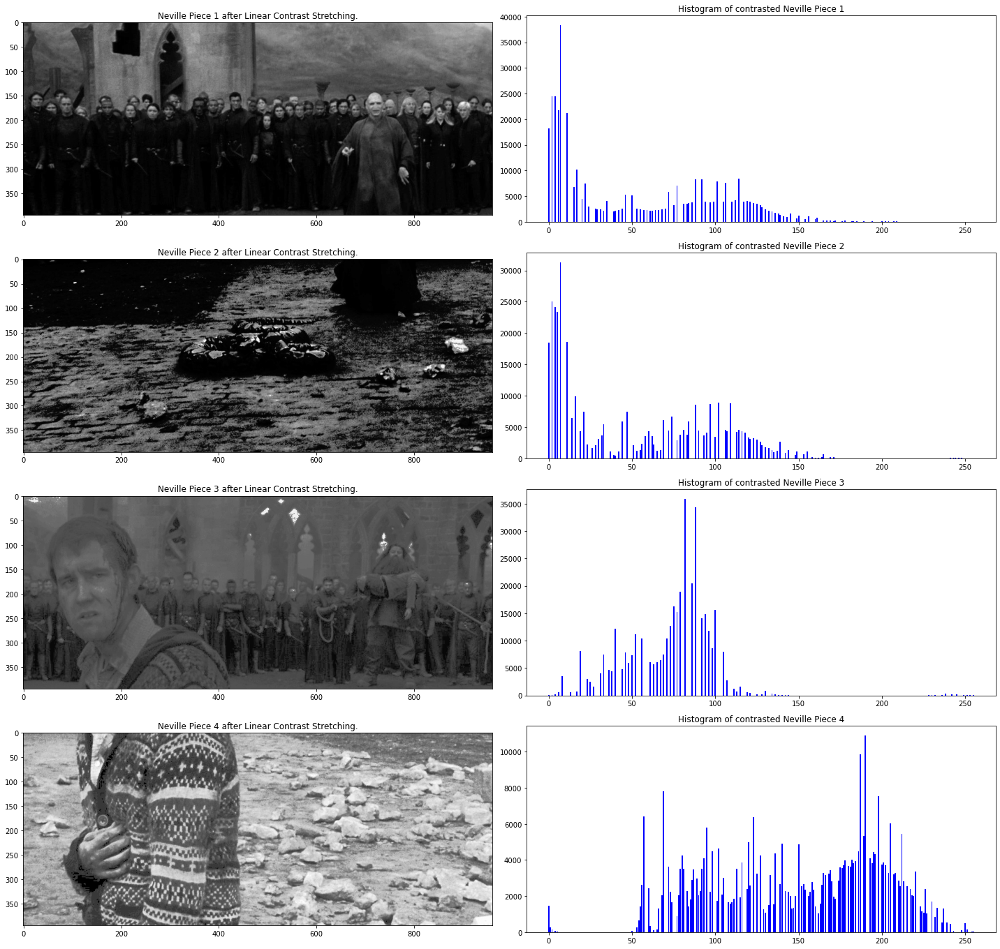

In [43]:
# Let's first do linear contrast stretching, along with their histogram to see how they look
nevilles_contrast = [linContrastStretching(nevilles[i], 0, 255, img_mode = "1C") for i in range(4)]
# Show each of them and their corresponding histogram...
fig, ax = plt.subplots(nrows = 4, ncols = 2, figsize = (20, 20))
for i in range(4):
    ax[i, 0].imshow(nevilles_contrast[i], cmap = "gray", vmin = 0, vmax = 255)
    ax[i, 0].set_title(f"Neville Piece {i+1} after Linear Contrast Stretching.")
    ax[i, 1].bar(np.arange(256), pixel_freq(nevilles_contrast[i], 8)[:, 1], color = "blue")
    ax[i, 1].set_title(f"Histogram of contrasted Neville Piece {i+1}")
fig.tight_layout(rect = [0,0,1,0.95]); plt.show()

### TRIAL 2: Linear Contrast Stretching (With Trimming)

Enter by what % you want to trim pixel-axis from left: 0
Enter by what % you want to trim pixel-axis from right: 10
Enter by what % you want to trim pixel-axis from left: 0
Enter by what % you want to trim pixel-axis from right: 22
Enter by what % you want to trim pixel-axis from left: 0
Enter by what % you want to trim pixel-axis from right: 40
Enter by what % you want to trim pixel-axis from left: 20
Enter by what % you want to trim pixel-axis from right: 0


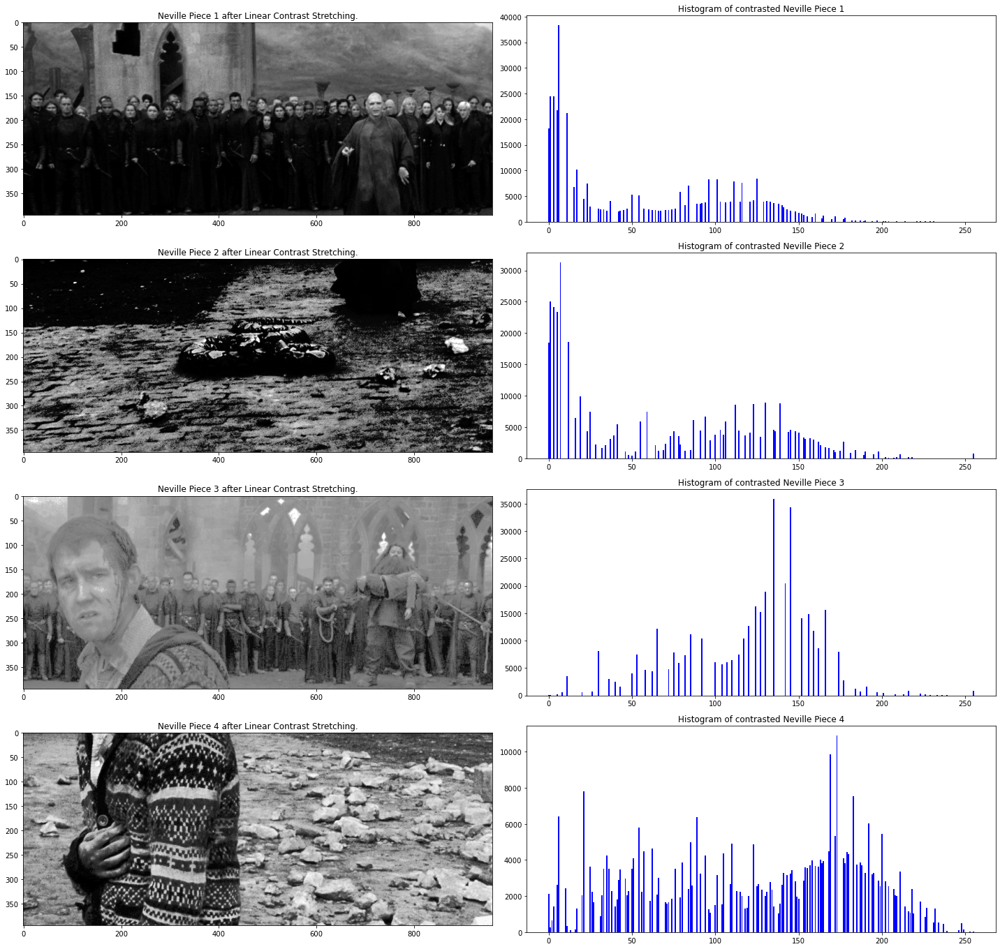

In [44]:
# Let's first do linear contrast stretching, along with their histogram to see how they look
nevilles_contrast_trim = [linContrastStretching(nevilles_contrast[i], 0, 255, version = 2, img_mode = "1C") for i in range(4)]
# Show each of them and their corresponding histogram...
fig, ax = plt.subplots(nrows = 4, ncols = 2, figsize = (20, 20))
for i in range(4):
    ax[i, 0].imshow(nevilles_contrast_trim[i], cmap = "gray", vmin = 0, vmax = 255)
    ax[i, 0].set_title(f"Neville Piece {i+1} after Linear Contrast Stretching.")
    ax[i, 1].bar(np.arange(256), pixel_freq(nevilles_contrast_trim[i], 8)[:, 1], color = "blue")
    ax[i, 1].set_title(f"Histogram of contrasted Neville Piece {i+1}")
fig.tight_layout(rect = [0,0,1,0.95]); plt.show()

__The results we got here are not that uniform in terms of contrast. Here the histogram is basically stretched after the operation.__

### TRIAL 3: Power Law Transform

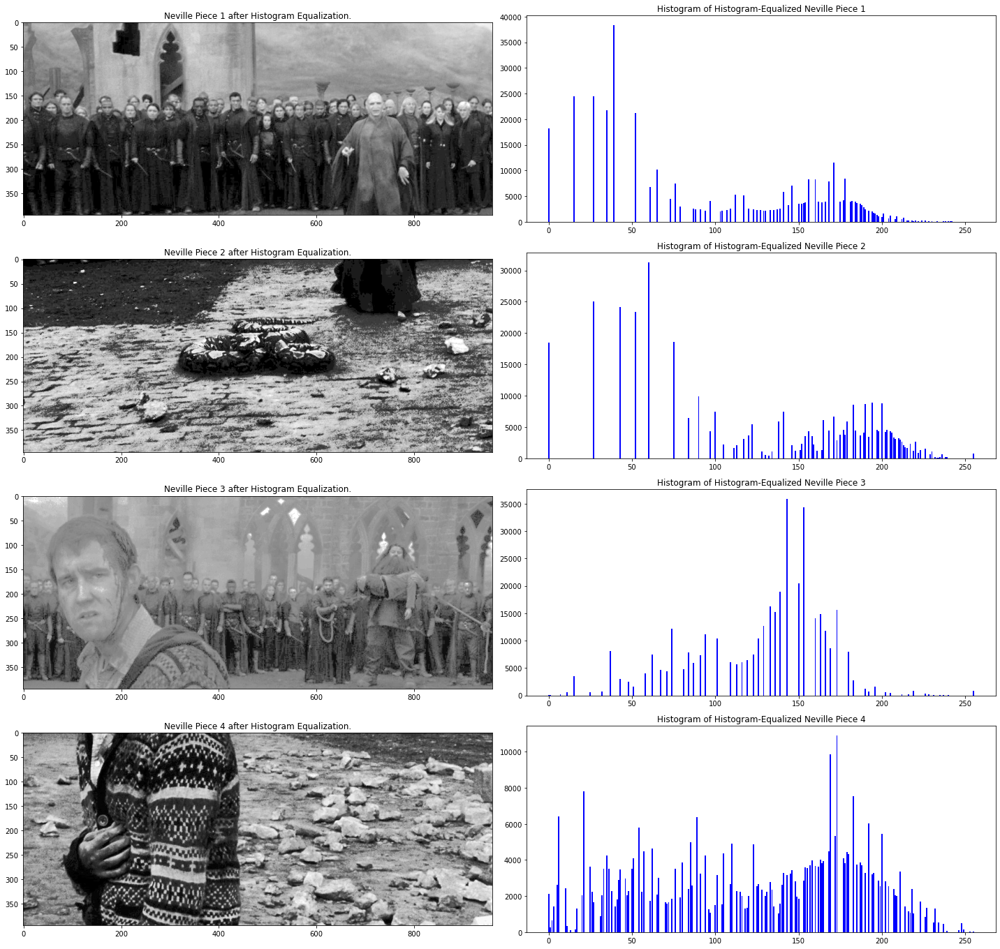

In [48]:
# Let's do HISTOGRAM Equalization and view them along with their Histograms.
gammas = [0.5, 0.4, 0.9, 1]
nevilles_power_transform = [gammaTransform(nevilles_contrast_trim[l], 8, gammas[l]) for l in range(4)]
# Show each of them and their corresponding histogram...
fig, ax = plt.subplots(nrows = 4, ncols = 2, figsize = (20, 20))
for i in range(4):
    ax[i, 0].imshow(nevilles_power_transform[i], cmap = "gray", vmin = 0, vmax = 255)#
    ax[i, 0].set_title(f"Neville Piece {i+1} after Histogram Equalization.")
    ax[i, 1].bar(np.arange(256), pixel_freq(nevilles_power_transform[i], 8)[:, 1], color = "blue")
    ax[i, 1].set_title(f"Histogram of Histogram-Equalized Neville Piece {i+1}")
fig.tight_layout(rect = [0,0,1,0.95]); plt.show()

__This has corrected the lighting of the first two images to some extent. Now these will be used for HISTOGRAM EQUALIZATION and will see what results we are getting.__

### TRIAL 4: Histogram Equalization

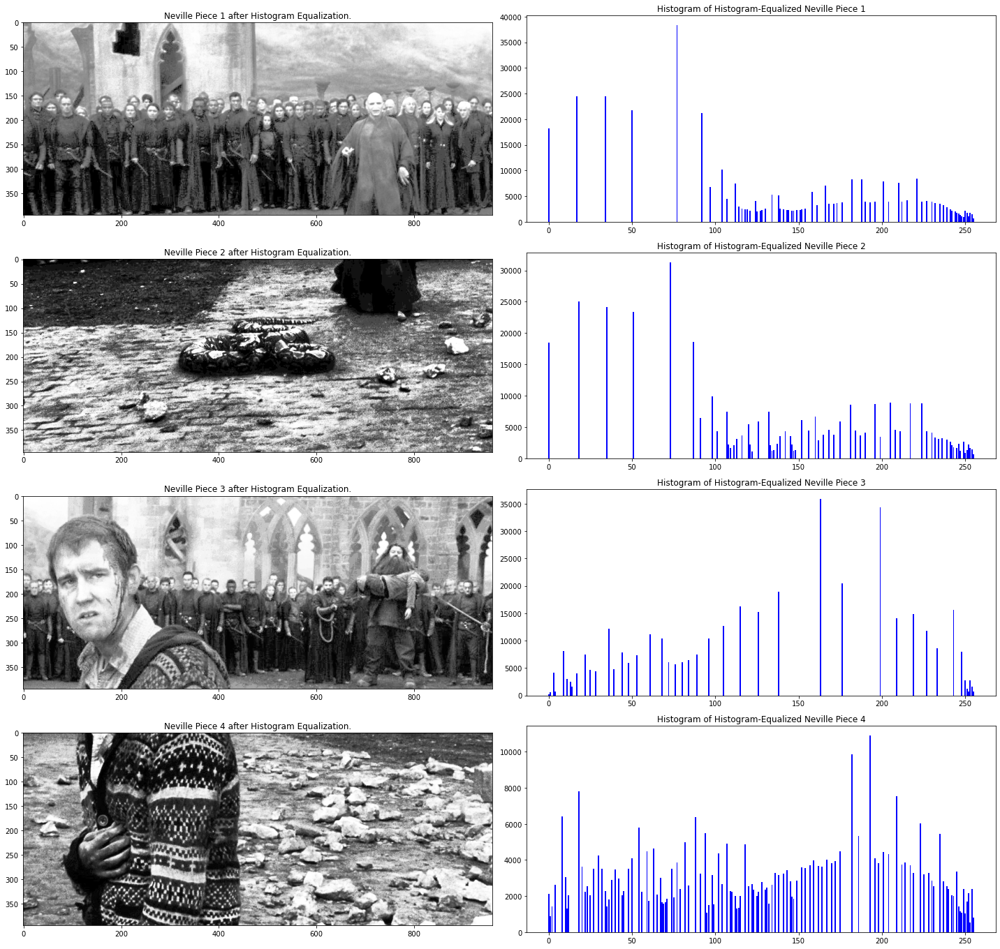

In [46]:
# Let's do HISTOGRAM Equalization and view them along with their Histograms.
nevilles_equalized = [histEqualization((nevilles_power_transform[l]).astype(np.uint8), 8, version = 2) for l in range(4)]
# Show each of them and their corresponding histogram...
fig, ax = plt.subplots(nrows = 4, ncols = 2, figsize = (20, 20))
for i in range(4):
    ax[i, 0].imshow(nevilles_equalized[i], cmap = "gray", vmin = 0, vmax = 255)#
    ax[i, 0].set_title(f"Neville Piece {i+1} after Histogram Equalization.")
    ax[i, 1].bar(np.arange(256), pixel_freq(nevilles_equalized[i], 8)[:, 1], color = "blue")
    ax[i, 1].set_title(f"Histogram of Histogram-Equalized Neville Piece {i+1}")
fig.tight_layout(rect = [0,0,1,0.95]); plt.show()

### CONCLUDING Transformations

1. _First_ image follows as shown below.
> Contrast Strectching (With Triming; Left: 0%, Right: 10%) ⟶ Power Transform ($\gamma = 0.5$) ⟶ Hist-Specification to Trimmed $4^{th}$ Image<!--Unicode for Right arrow = &#8594; or  &rarr;-->
2. _Second_ image follows as shown below.
> Contrast Strectching (With Triming; Left: 0%, Right: 22%) ⟶ Power Transform ($\gamma = 0.4$) ⟶ Hist-Specification to Trimmed $4^{th}$ Image<!--Unicode for Right arrow = &#8594;-->
3. _Third_ image follows as shown below.
> Contrast Strectching (Without Triming) ⟶ Hist-Specification to Trimmed $4^{th}$ Image
4. _Fourth_ image follows as shown below.
> Contrast Strectching (With Triming; Left: 20%, Right: 0%)

In [51]:
# Transforming piece 4 first, as this would be reference for next pieces
neville_4_transformed = nevilles_contrast_trim[3]

# Transforming piece 1. Since we're transforming the histogram in range given by Image, we are starting from "nevilles_contrast"
#gammaTransform(linContrastStretching(nevilles_contrast[0], 0, 255, version = 2, img_mode = "1C"), 8, 0.5)
neville_1_transformed = histMatching(nevilles_power_transform[0], neville_4_transformed, 8)

# Transforming piece 1. Since we're transforming the histogram in range given by Image, we are starting from "nevilles_contrast"
neville_2_transformed = histMatching(nevilles_power_transform[1], neville_4_transformed, 8)

# Transforming piece 1. Since we're transforming the histogram in range given by Image, we are starting from "nevilles_contrast"
neville_3_transformed = histMatching(nevilles_contrast[2], neville_4_transformed, 8)

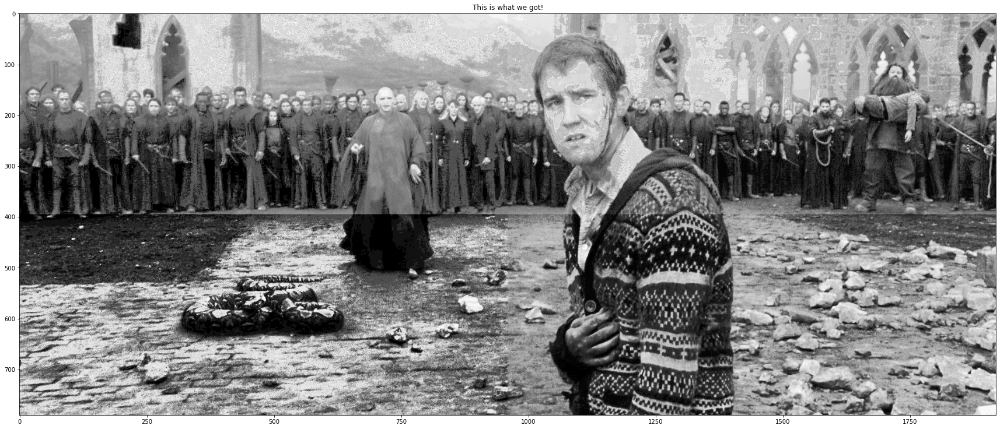

In [52]:
# Visualize the images obtained...
top_part = cv2.hconcat([neville_1_transformed, neville_3_transformed])
bottom_part = cv2.hconcat([neville_2_transformed, neville_4_transformed])
final_img = cv2.vconcat([top_part, bottom_part])
plt.figure(figsize=(30, 30))
plt.imshow(final_img, cmap = "gray", vmin = 0, vmax = 255); plt.title("This is what we got!"); plt.show()

## Rough

In [ ]:
# Load two images
img1 = cv2.imread(abs_path + 'src/messi5.jpg')
img2 = cv2.imread(abs_path + 'src/opencv.png')
# I want to put logo on top-left corner, So I create a ROI
rows, cols, channels = img2.shape
roi = img1[0:rows, 0:cols]
# Now create a mask of logo and create its inverse mask also
img2gray = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)
ret, mask = cv2.threshold(img2gray, 10, 255, cv2.THRESH_BINARY)
mask_inv = cv2.bitwise_not(mask)
# Now black-out the area of logo in ROI
img1_bg = cv2.bitwise_and(roi, roi, mask=mask_inv)
# Take only region of logo from logo image.
img2_fg = cv2.bitwise_and(img2, img2, mask=mask)
# Put logo in ROI and modify the main image
dst = cv2.add(img1_bg, img2_fg)

In [ ]:
plt.imshow(img1_bg)

plt.imshow(img2_fg)  #; plt.imshow(img2gray)

plt.imshow(mask_inv, cmap='gray')

plt.imshow(dst)

In [ ]:
dtypes = np.int64, np.float64, np.uint8, '>i2'

for dtype in dtypes:
    print(f"{dtype} is integer? {np.issubdtype(dtype, np.integer)}")

tt = np.array([1, 2, 3])
assert tt.dtype in dtypes, "Error"

In [ ]:
rr = np.floor(np.array([256, 127, 51]) // 2**2).astype(np.uint8)
rr.dtype
print(rr)

* numpy.intc int  Platform-defined
* numpy.uintc  unsigned int Platform-defined
* numpy.int_ long Platform-defined
* numpy.uint unsigned long Platform-defined
* numpy.short short Platform-defined
* numpy.longlong long long Platform-defined
* numpy.ulonglong unsigned long long Platform-defined

In [ ]:
arr1 = np.array([0.,0,0,0,0,0.,0,0,1,2,3,4,5,6,7,8,9])
print(np.argwhere(arr1 != 0))
print(np.where(arr1 != 0, 1, 0)) # or np.where(arr1 == 0, 0, 1) --> where condition is true, put 0 or else 1.
print(arr1[np.where(arr1 != 0)])
print(np.where(arr1 != 0))
"""
a = np.array(['apple', 'orange', 'apple', 'banana'])

arr_index = np.where(a == 'apple')

print(arr_index)

print(a[arr_index])
"""

 Comparing Binary Search and Numpy implementation

In [70]:
lst = [1, 2, 3, 4, 5, 6, 9, 11, 15, 20]
import time
tt = time.time()
print(binary_search(lst, 13, len(lst)-1, 0))
print(time.time() - tt)

7
0.0003440380096435547


In [71]:
lst_arr = np.array(lst)
tt1 = time.time()
print(np.argmax(lst_arr[lst_arr < 13]))
print(time.time() - tt1)

7
0.001184701919555664


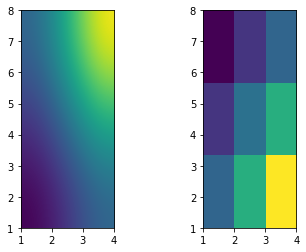

In [70]:
a = np.array([0.313660827978, 0.365348418405, 0.423733120134, 
              0.365348418405, 0.439599930621, 0.525083754405, 
              0.423733120134, 0.525083754405, 0.651536351379]).reshape(3,3)

extent = [1,4,1,8] # sets the axis length

fig, axs = plt.subplots(1,2)

axs[0].imshow(a, extent=extent, interpolation='bicubic', origin='lower')#, interpolation='none'
#https://matplotlib.org/2.0.2/examples/images_contours_and_fields/interpolation_methods.html
axs[1].imshow(a, extent=extent, interpolation='none')# , origin='lower'

In [4]:
import time
tt = time.time()
a,b,c, d, e, f, g = 1,4,5, 7, 8, 9, 10
print(time.time() - tt)
kk = time.time()
a = 1; b = 4; c = 5; d = 7; e = 8; f = 9; g = 10
print(time.time() - kk)

0.0001437664031982422
0.0003407001495361328
